In [1]:
import json
import os
import numpy as np
from keras.models import Model,load_model
from keras.layers import Input, LSTM, Dense,Activation,Embedding,merge,TimeDistributed
from keras.layers.core import Lambda
from keras.layers import concatenate,Reshape,Concatenate,RepeatVector,add
from keras.applications.vgg16 import VGG16
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input
from keras.utils import plot_model
import numpy as np
import tensorflow as tf
import keras.backend.tensorflow_backend as KTF
from nltk.translate.bleu_score import sentence_bleu
from keras.callbacks import EarlyStopping
import random
from PIL import Image
from matplotlib import pyplot as plt
import pickle
from keras import backend as K
import math
import random

Using TensorFlow backend.


In [2]:
KTF.clear_session()

In [3]:
coco_json='./data/dataset_coco.json'
tokenfile='./tokenv2.pkl'
detokenfile='./detokenv2.pkl'

os.environ['CUDA_VISIBLE_DEVICES'] = '0'
config = tf.ConfigProto()
config.gpu_options.allow_growth=True
session = tf.Session(config=config)

KTF.set_session(session)

In [4]:
with open(coco_json) as file:
    lines=file.readlines()
data=json.loads(lines[0])['images']

In [5]:
train_x_file=[]
train_y_seq=[]
vali_x_file=[]
vali_y_seq=[]
token={}
with open(tokenfile,'rb') as file:
    token=pickle.load(file)

In [6]:
for d in data:
    if d['split']=='train':
        for sen in d['sentences']:
            train_x_file.append('./coco/'+d['filepath']+'/'+d['filename'])
            seq=sen['tokens']
            train_y_seq.append(['\t']+seq+['\n'])
    if d['split']=='test':
        for sen in d['sentences']:
            vali_x_file.append('./coco/'+d['filepath']+'/'+d['filename'])
            seq=sen['tokens']
            vali_y_seq.append(['\t']+seq+['\n'])

In [7]:
with open(detokenfile,'rb') as file:
    detoken=pickle.load(file)

In [8]:
num_tokens=len(token)
batch_size=64
seq_len=49+2 #49+'\t'+'\n'
vec_len=4096


print("Num of vali:",len(vali_x_file))
print("Num of token:",num_tokens)
print("Len of vector:",vec_len)


Num of vali: 25010
Num of token: 24157
Len of vector: 4096


In [9]:
vgg = VGG16(weights='imagenet')
vgg.layers.pop()
vggmodel=Model(inputs=vgg.inputs,outputs=vgg.layers[-1].output)

def vggextract(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    #return vggmodel.predict(x)
    return np.reshape(vggmodel.predict(x),(4096))
a=vggextract('./file/000001.jpg')

In [10]:
latent_dim=128
encode_input=Input(shape=(vec_len,))
encode_dense=Dense(latent_dim,activation='relu')(encode_input)
#encode_dense=RepeatVector(1)(encode_dense) repeat only one time, for 1+51->52
encode_dense=RepeatVector(51)(encode_dense)
decode_input=Input(shape=(seq_len,))
decode_emb=Embedding(num_tokens+1,latent_dim,input_length=(seq_len))(decode_input)
#decoder_vec=concatenate([decode_emb,encode_dense],axis=1) for 1+51->52
decoder_LSTM=LSTM(latent_dim*2,return_sequences=True)(decode_emb)
decoder_timedistri=TimeDistributed(Dense(latent_dim))(decoder_LSTM)
decoder_vec=concatenate([encode_dense,decoder_timedistri])
decoder=LSTM(latent_dim*2)(decoder_vec)
decoder=Dense(num_tokens,activation='softmax')(decoder)
model=Model([encode_input,decode_input],decoder)


In [11]:
model.compile(loss='sparse_categorical_crossentropy', optimizer='adam',metrics=['accuracy'])
model.load_weights('vgg_best_weight.h5')

In [15]:
def decode(code,seq,seq_index,sentence):
    decode_token_index=np.argmax(model.predict([code,seq])[0])
    seq[0][seq_index]=decode_token_index
    if decode_token_index==0:
        sampled_char=' '
        #print("Sampled:",decode_token_index," ")
    else:
        sampled_char=detoken[decode_token_index]
        #print("Sampled:",decode_token_index,sampled_char)
    sentence+=(" "+sampled_char)
    if seq_index+1==seq_len or sampled_char=='\n':
        return sentence
    else:
        return decode(code,seq,seq_index+1,sentence)

-
Input


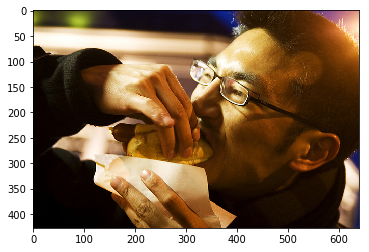

Decoded sentence:  a man is holding a cellphone in a cellphone 

should be: ['\t', 'a', 'man', 'with', 'glasses', 'holds', 'a', 'hot', 'dog', 'in', 'his', 'mouth', '\n']
-
Input


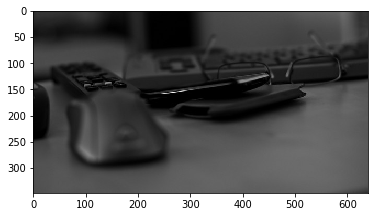

Decoded sentence:  a cellphone with a cellphone on a mouse 

should be: ['\t', 'the', 'glasses', 'are', 'the', 'only', 'non', 'electronic', 'equipment', 'here', '\n']
-
Input


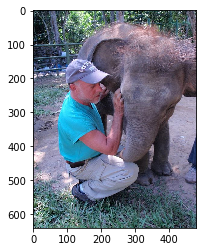

Decoded sentence:  a elephant with a elephant and a elephant 

should be: ['\t', 'a', 'man', 'kneeling', 'down', 'by', 'a', 'little', 'elephant', '\n']
-
Input


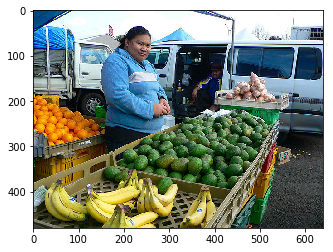

Decoded sentence:  a man with a parka and food and bananas 

should be: ['\t', 'a', 'woman', 'standing', 'at', 'an', 'outdoor', 'display', 'of', 'assorted', 'fruit', '\n']
-
Input


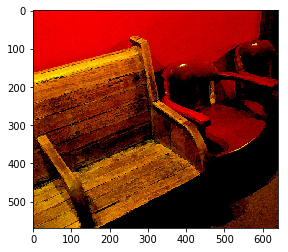

Decoded sentence:  a toy pump is sitting on a matching mound 

should be: ['\t', 'a', 'wooden', 'bench', 'sitting', 'next', 'to', 'two', 'red', 'chairs', '\n']
-
Input


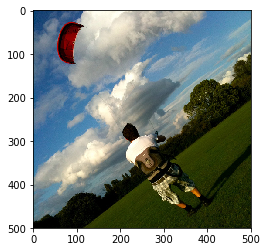

Decoded sentence:  a man flying a kite on the beach 

should be: ['\t', 'a', 'male', 'in', 'a', 'white', 'shirt', 'a', 'red', 'kite', 'and', 'clouds', '\n']
-
Input


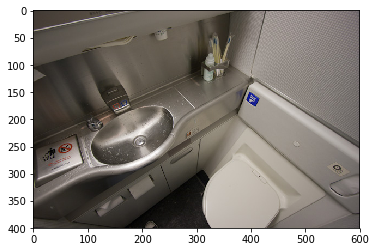

Decoded sentence:  a white walled toilet and a ruler hole and a toilet 

should be: ['\t', 'a', 'top', 'view', 'of', 'compact', 'toilet', 'and', 'a', 'stainless', 'steel', 'sink', '\n']
-
Input


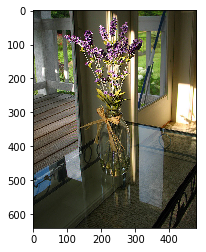

Decoded sentence:  a vase with a vase in a glass vase 

should be: ['\t', 'a', 'lavender', 'flower', 'bouquet', 'in', 'a', 'clear', 'glass', 'vase', '\n']
-
Input


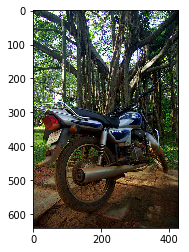

Decoded sentence:  a motorcycle is parked on a motorcycle 

should be: ['\t', 'a', 'motor', 'bike', 'parked', 'in', 'a', 'stationary', 'position', 'by', 'some', 'trees', '\n']
-
Input


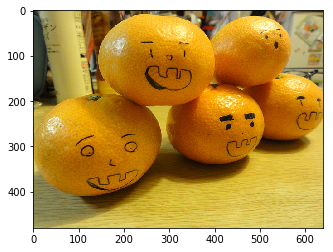

Decoded sentence:  a fruit and oranges on a orange board 

should be: ['\t', 'a', 'pile', 'of', 'oranges', 'stacked', 'on', 'top', 'of', 'each', 'one', 'with', 'faces', '\n']
-
Input


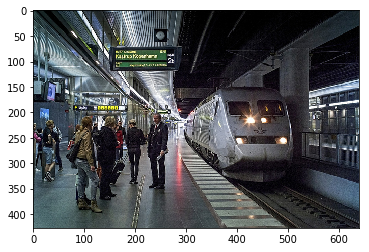

Decoded sentence:  a train decker train train on a train 

should be: ['\t', 'people', 'stand', 'on', 'the', 'platform', 'as', 'a', 'train', 'pulls', 'into', 'the', 'station', '\n']
-
Input


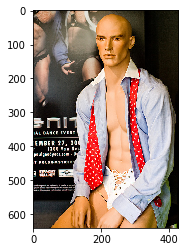

Decoded sentence:  a man is holding a ponytail expression in a creepy boddy 

should be: ['\t', 'a', 'mannequin', 'wearing', 'a', 'jock', 'strap', 'unbuttoned', 'shirt', 'and', 'tie', '\n']
-
Input


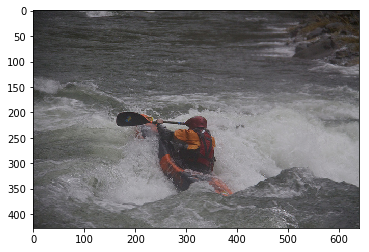

Decoded sentence:  a surfer is riding a strong surfboard 

should be: ['\t', 'an', 'individual', 'on', 'a', 'kayak', 'riding', 'through', 'waves', 'of', 'water', '\n']
-
Input


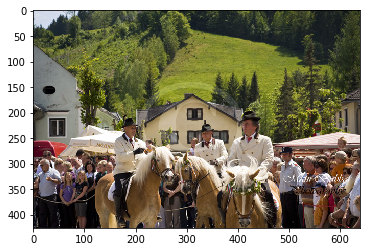

Decoded sentence:  a group of people are are are are are standing on a street 

should be: ['\t', 'a', 'group', 'of', 'men', 'riding', 'on', 'the', 'back', 'of', 'horses', '\n']
-
Input


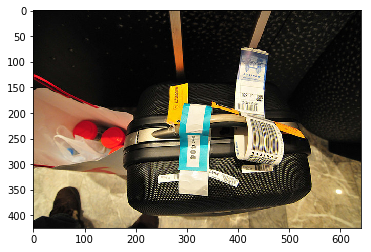

Decoded sentence:  a toy and a bed on a bed 

should be: ['\t', 'the', 'luggage', 'contains', 'tags', 'from', 'several', 'different', 'locations', '\n']
-
Input


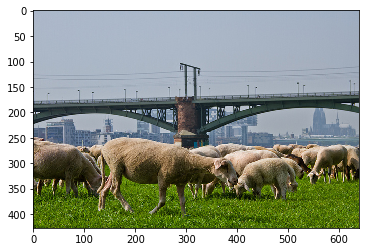

Decoded sentence:  a herd of animals in a campground field 

should be: ['\t', 'a', 'view', 'of', 'some', 'animals', 'are', 'in', 'the', 'grass', '\n']
-
Input


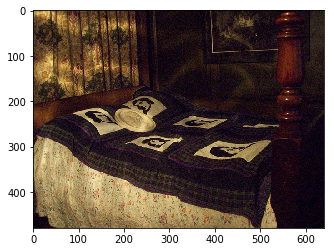

Decoded sentence:  a dog sitting on a bed with a bed 

should be: ['\t', 'a', 'quilt', 'lays', 'across', 'the', 'bed', 'by', 'the', 'window', '\n']
-
Input


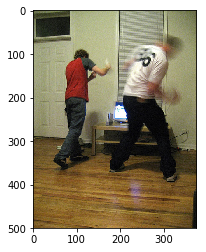

Decoded sentence:  a man is sitting on a skateboard in a hairstylist room 

should be: ['\t', 'two', 'men', 'playing', 'interactive', 'video', 'games', 'on', 'a', 'small', 'tv', '\n']
-
Input


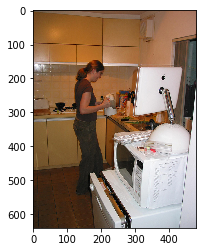

Decoded sentence:  a man heating in a kitchen with a kitchen 

should be: ['\t', 'a', 'woman', 'is', 'working', 'in', 'a', 'small', 'kitchen', '\n']
-
Input


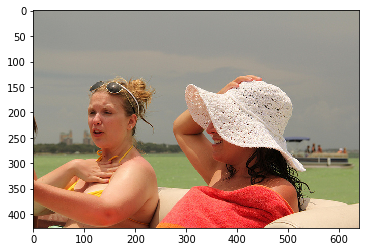

Decoded sentence:  a man is playing a frisbee on a surfboard 

should be: ['\t', 'two', 'women', 'sitting', 'in', 'a', 'boat', 'engaging', 'in', 'a', 'conversation', '\n']
-
Input


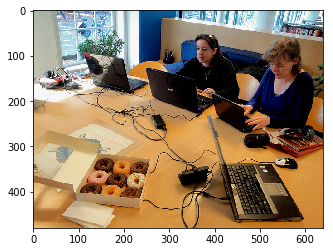

Decoded sentence:  a laptop sitting on a desk with a desk 

should be: ['\t', 'two', 'women', 'sitting', 'at', 'a', 'table', 'that', 'have', 'multiple', 'laptops', '\n']
-
Input


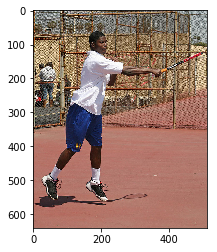

Decoded sentence:  a man is playing a tennis ball 

should be: ['\t', 'a', 'young', 'man', 'playing', 'tennis', 'outdoors', 'at', 'a', 'tennis', 'park', '\n']
-
Input


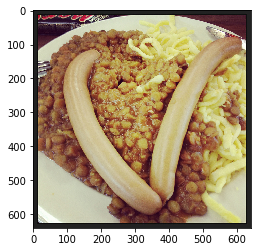

Decoded sentence:  a plate with a sandwich and a sandwich and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and cheese and french
should be: ['\t', 'a', 'plate', 'of', 'beans', 'has', 'two', 'hot', 'dogs', 'in', 'the', 'shape', 'of', 'a', 'v', 'on', 'top', '\n']
-
Input


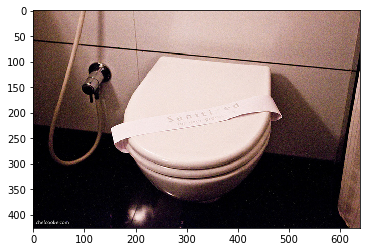

Decoded sentence:  a man sitting on a bathroom with a sink 

should be: ['\t', 'a', 'closed', 'toilet', 'with', 'a', 'sanitized', 'sign', 'on', 'it', '\n']
-
Input


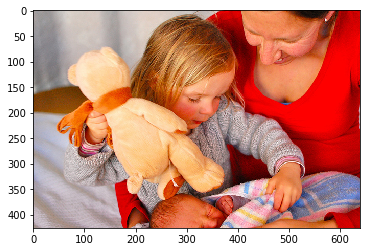

Decoded sentence:  a girl is eating a banana on a bed 

should be: ['\t', 'there', 'is', 'a', 'young', 'girl', 'that', 'is', 'holding', 'a', 'stuffed', 'bear', '\n']
-
Input


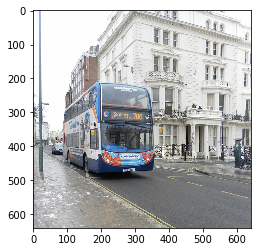

Decoded sentence:  a bus stopped down a street with a bus 

should be: ['\t', 'a', 'double', 'decker', 'bus', 'driving', 'up', 'a', 'street', '\n']
-
Input


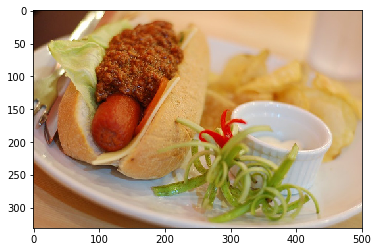

Decoded sentence:  a plate with a plate with a plate with a plate 

should be: ['\t', 'a', 'plate', 'with', 'a', 'chili', 'hot', 'dog', 'and', 'chips', '\n']
-
Input


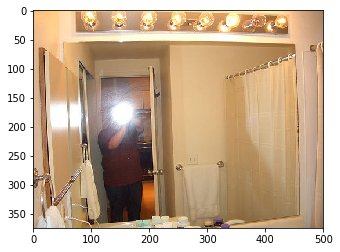

Decoded sentence:  a bathroom with a sink and a sink and a sink 

should be: ['\t', 'a', 'person', 'taking', 'a', 'picture', 'with', 'the', 'light', 'reflecting', 'in', 'the', 'mirror', '\n']
-
Input


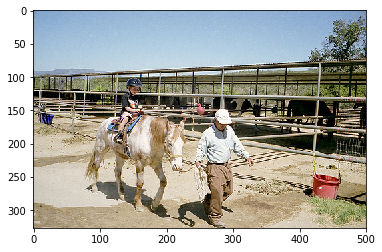

Decoded sentence:  a man is riding a horse on a fenced 

should be: ['\t', 'a', 'boy', 'is', 'on', 'a', 'pony', 'being', 'led', 'by', 'a', 'man', '\n']
-
Input


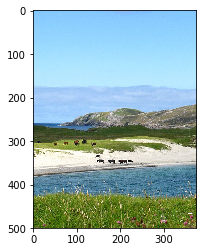

Decoded sentence:  a large boat is seen in the water 

should be: ['\t', 'cattle', 'at', 'an', 'idyllic', 'lakeside', 'in', 'the', 'hills', '\n']
-
Input


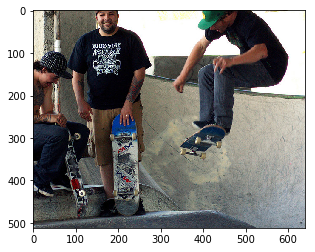

Decoded sentence:  a man is standing on a skateboard in a skate park 

should be: ['\t', 'a', 'skater', 'doing', 'a', 'trick', 'for', 'two', 'other', 'skaters', '\n']
-
Input


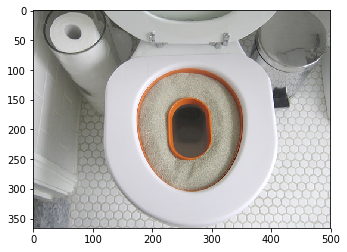

Decoded sentence:  a white cake with a white fitted and potty potty potty potty liquid 

should be: ['\t', 'a', 'toilet', 'has', 'a', 'special', 'seat', 'and', 'is', 'sitting', 'near', 'a', 'trash', 'can', '\n']


In [17]:
indices=random.sample(range(len(train_x_file)),32)
for index in indices:
    code=vggextract(train_x_file[index])
    code=np.reshape(code,(1,code.shape[0]))
    did=np.zeros(
        (seq_len),dtype='float32'
    )
    did=np.reshape(did,(1,did.shape[0]))
    did[0][0]=float(token['\t'])
    sentence=decode(code,did,1,"")
    print("-")
    print("Input")
    plt.imshow(np.asarray(Image.open(train_x_file[index])))
    plt.show()
    print("Decoded sentence:",sentence)
    print("should be:",train_y_seq[index])

-
Input


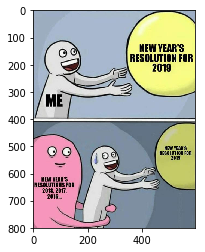

Decoded sentence:  a figurine figurine figurine figurine with a hospital vent 

-
Input


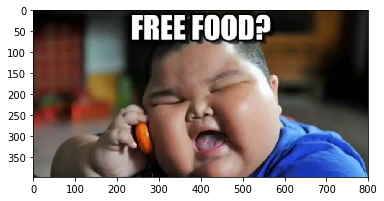

Decoded sentence:  a woman is holding a lion and a lion and a bottle of creature apples 

-
Input


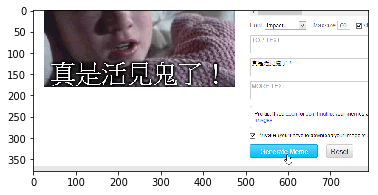

Decoded sentence:  a man is wearing a pair of scissors 

-
Input


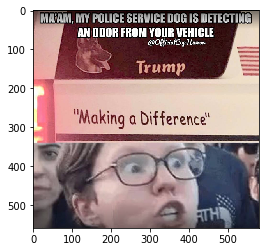

Decoded sentence:  a man is holding a cellphone while a cellphone 

-
Input


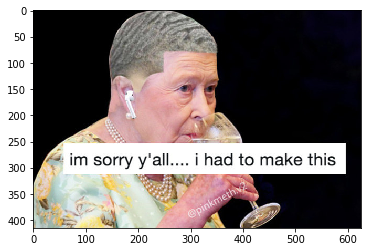

Decoded sentence:  a man is holding a hat with a hat cuffs phones 

-
Input


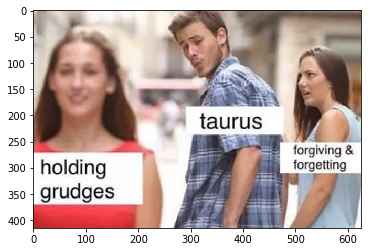

Decoded sentence:  a woman is holding a cellphone in a cellphone 

-
Input


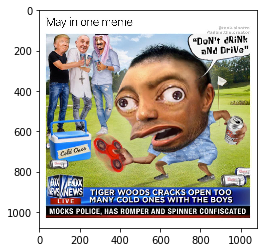

Decoded sentence:  a woman is holding a store with a teddy bear 

-
Input


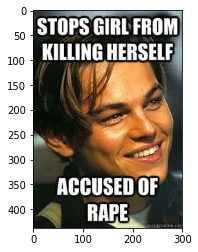

Decoded sentence:  a man wearing a cellphone in a cellphone 

-
Input


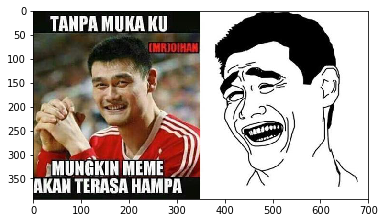

Decoded sentence:  a man is standing on a tennis court 

-
Input


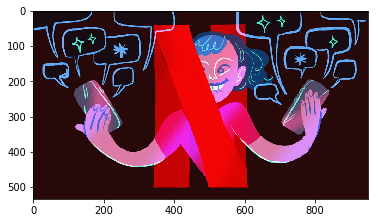

Decoded sentence:  a circle with a bunch of scissors and a bag 

-
Input


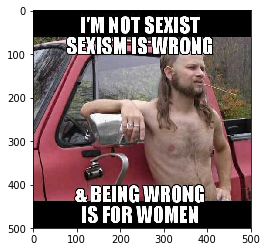

Decoded sentence:  a man is riding a motorcycle in front of a car 

-
Input


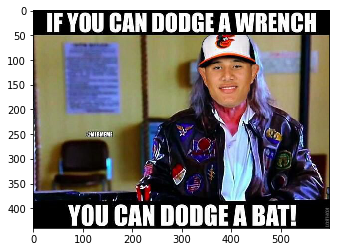

Decoded sentence:  a man is riding a skateboard on a street 

-
Input


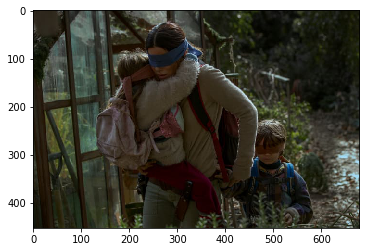

Decoded sentence:  a man is sitting on a vespa with a building 

-
Input


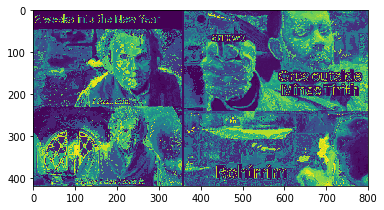

Decoded sentence:  a man is standing on a skateboard in front of a building 

-
Input


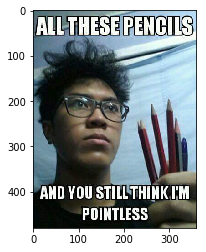

Decoded sentence:  a man is holding a ponytail and tie 

-
Input


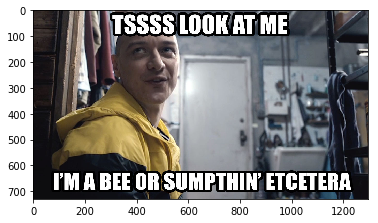

Decoded sentence:  a man is sitting on a cellular umbrella 

-
Input


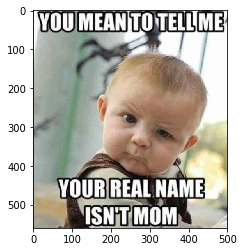

Decoded sentence:  a man is laying on a hat with a hat 

-
Input


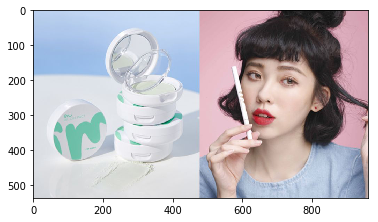

Decoded sentence:  a man is holding a pencil tie in a workbook 

-
Input


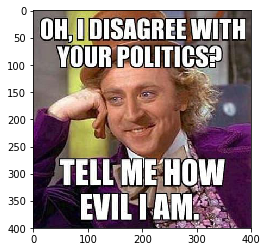

Decoded sentence:  a man is wearing a button arm in a chair 

-
Input


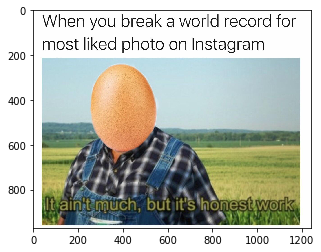

Decoded sentence:  a man is holding a tennis racket in a tennis racket 

-
Input


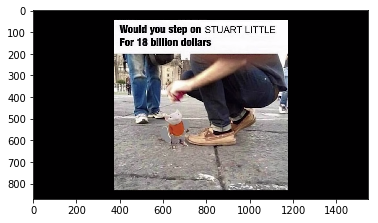

Decoded sentence:  a man on a trick on a skateboard 

-
Input


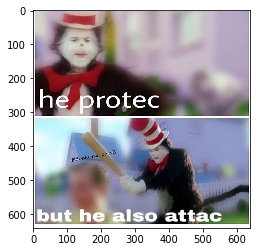

Decoded sentence:  a man wearing a hat with a hat in a mirror 

-
Input


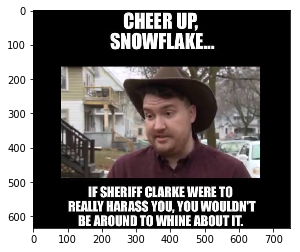

Decoded sentence:  a man is standing on a plaid plaid street 

-
Input


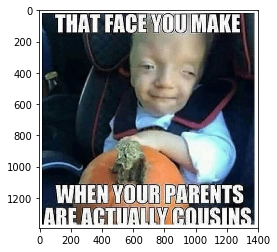

Decoded sentence:  a man sitting on a chair with a teddy bear 

-
Input


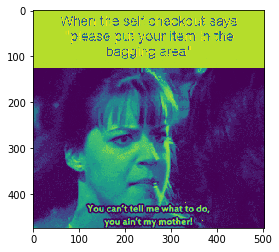

Decoded sentence:  a man wearing a tie in a tie 

-
Input


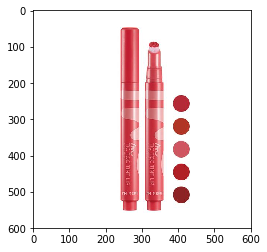

Decoded sentence:  a bottle of images of a baggie with yarn and toiletries 

-
Input


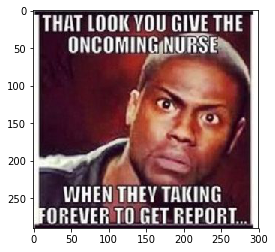

Decoded sentence:  a man wearing a tie in a tie 

-
Input


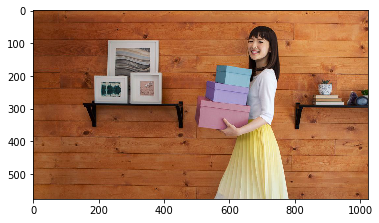

Decoded sentence:  a man is sitting on a kitchen with a magnet 

-
Input


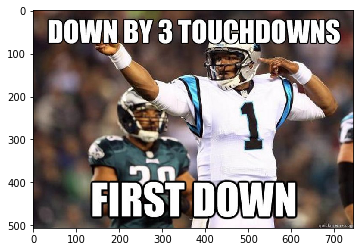

Decoded sentence:  a man is riding a baseball bat 

-
Input


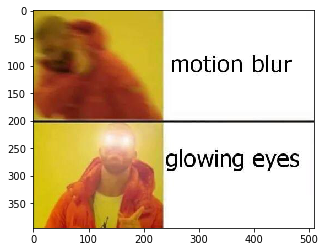

Decoded sentence:  a man is wearing brave in a shadowy park 

-
Input


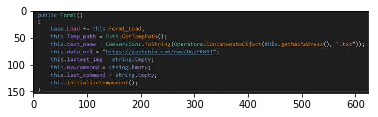

Decoded sentence:  a street with a cellphone on a cellphone 

-
Input


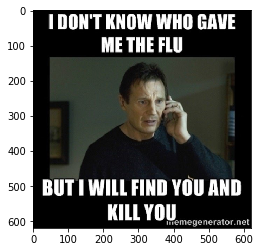

Decoded sentence:  a man is standing on a skateboard with a skateboard 

-
Input


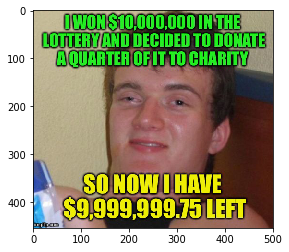

Decoded sentence:  a man is cleaning a cellphone in a cellphone 

-
Input


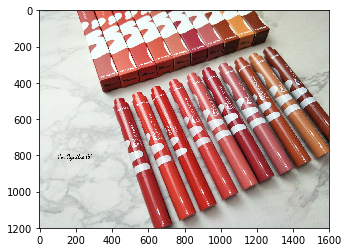

Decoded sentence:  a number of luggage are on a circle in the snow 

-
Input


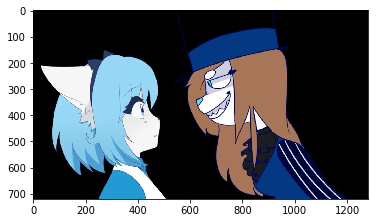

Decoded sentence:  a large picture of a shadowy elaborate elaborate designs 

-
Input


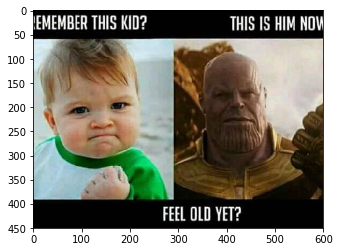

Decoded sentence:  a man is standing in a stage with a stage 

-
Input


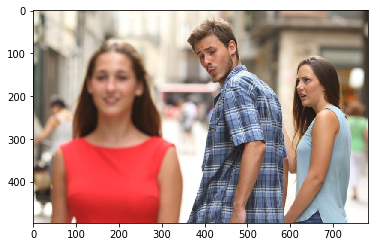

Decoded sentence:  a man is sitting on a bench in a parking phone 

-
Input


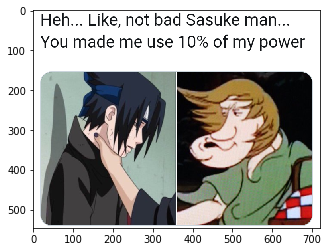

Decoded sentence:  a man is holding a turban in a shadowy hoop 

-
Input


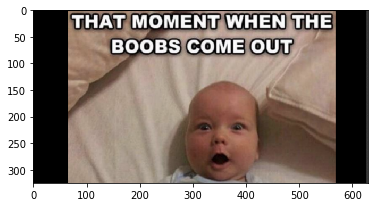

Decoded sentence:  a man is wearing a remote controller with a remote 

-
Input


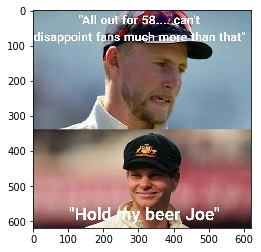

Decoded sentence:  a man wearing a tennis ball in a tennis ball 

-
Input


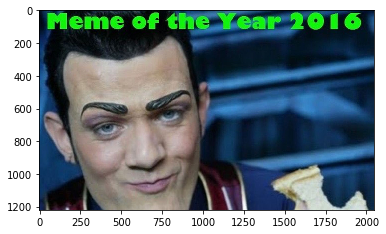

Decoded sentence:  a man is holding a cellphone with a cellphone 

-
Input


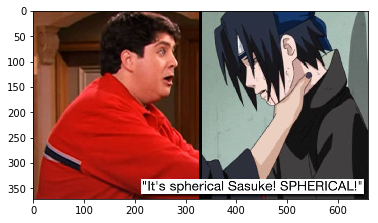

Decoded sentence:  a man is a serious shirt in a skateboard 

-
Input


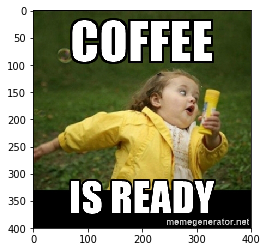

Decoded sentence:  a man wearing a tennis racket in a tennis 

-
Input


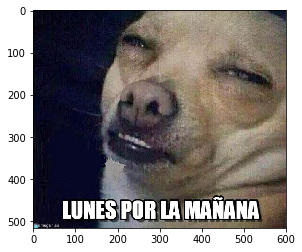

Decoded sentence:  a dog is laying on a remote control 

-
Input


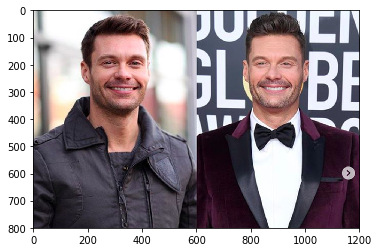

Decoded sentence:  a man in a suit and tie in a man 

-
Input


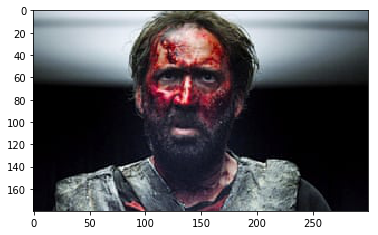

Decoded sentence:  a man is sitting on a skateboard in front of a car 

-
Input


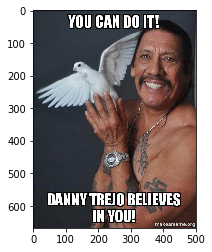

Decoded sentence:  a man wearing a hat with a hat in a tie 

-
Input


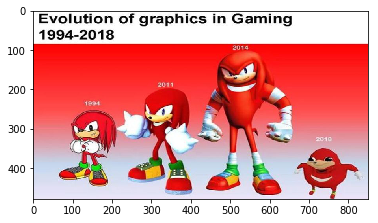

Decoded sentence:  a figurine is on a stage with a stage 

-
Input


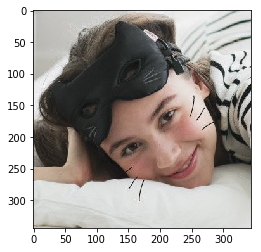

Decoded sentence:  a cat laying on a bed with a laptop and a laptop 

-
Input


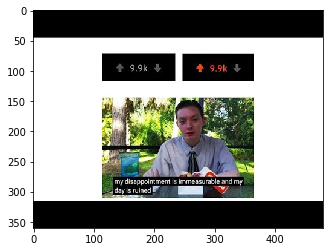

Decoded sentence:  a man is players on a field with a tennis field 

-
Input


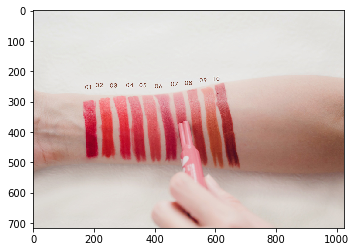

Decoded sentence:  a man is wearing a hat with a hat in the air 

-
Input


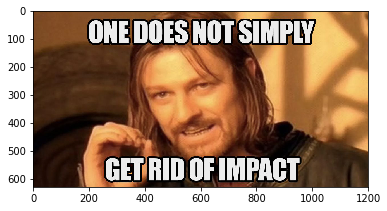

Decoded sentence:  a man is standing on a tennis court 

-
Input


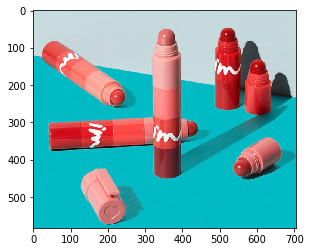

Decoded sentence:  a control and scissors and a smaller bear and thread 

-
Input


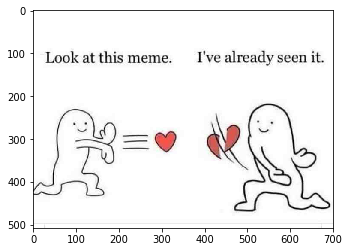

Decoded sentence:  a montage of a shadowy kite in a pointed sign 

-
Input


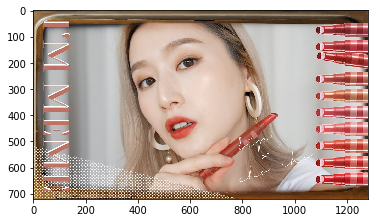

Decoded sentence:  a kitchen captures lost and a lost design 

-
Input


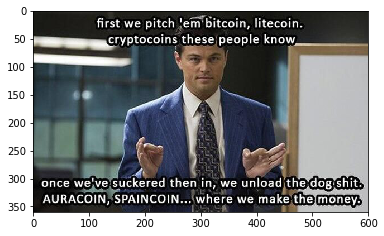

Decoded sentence:  a man in a serious shirt and tie 

-
Input


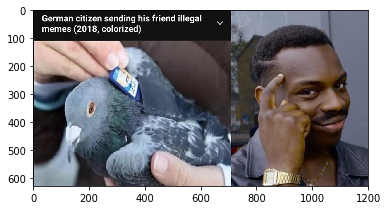

Decoded sentence:  a woman is sitting on a hoop with a hoop 

-
Input


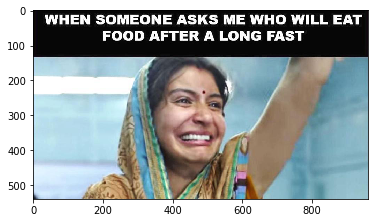

Decoded sentence:  a man is holding a hat and wrist and tie 

-
Input


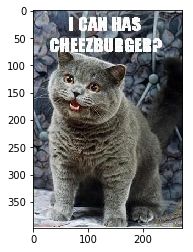

Decoded sentence:  a cat is sitting on a chair 

-
Input


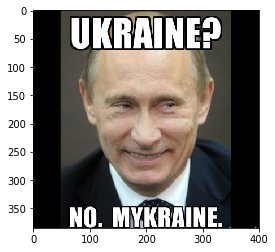

Decoded sentence:  a man wearing a hat with a hat and tie 

-
Input


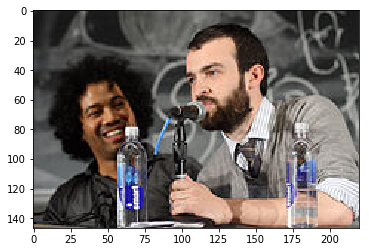

Decoded sentence:  a man is wearing a pic cuffs a pic and blow cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs ear 

-
Input


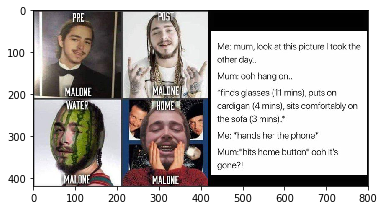

Decoded sentence:  a man is standing on a ledge with a vespa 

-
Input


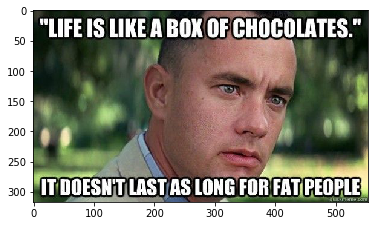

Decoded sentence:  a man wearing a hat and a hat 

-
Input


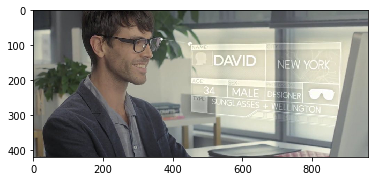

Decoded sentence:  a man is holding a cellphone in a cellphone 

-
Input


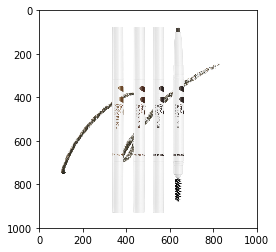

Decoded sentence:  a mine jumper is on a snowy lift 

-
Input


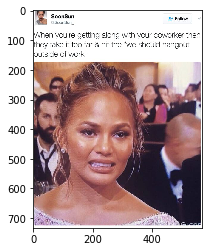

Decoded sentence:  a man wearing a suit and tie in a suit 

-
Input


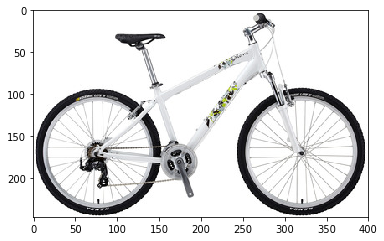

Decoded sentence:  a man is riding a skateboard in a skate park 

-
Input


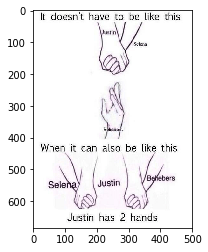

Decoded sentence:  a figurine youths images of a perch 

-
Input


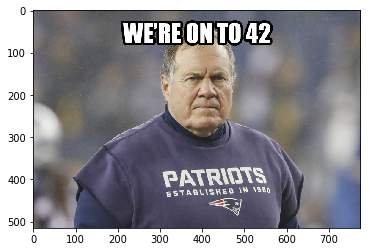

Decoded sentence:  a man is standing on front of a tennis ball 

-
Input


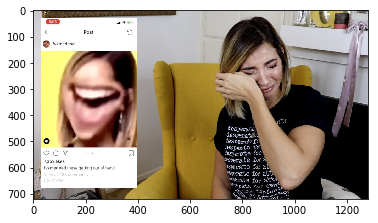

Decoded sentence:  a woman is holding a cellphone in a cellphone 

-
Input


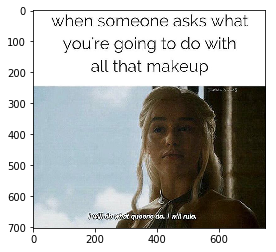

Decoded sentence:  a man is wearing a teddy bear and a teddy bear 

-
Input


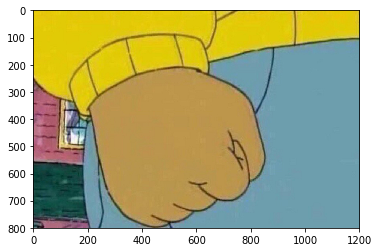

Decoded sentence:  a view of a polka rod and designs and a landscape 

-
Input


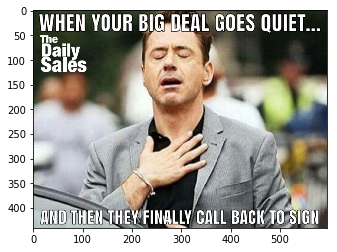

Decoded sentence:  a man wearing a hat with a hat in a man 

-
Input


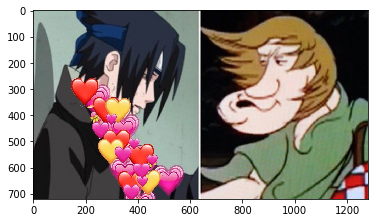

Decoded sentence:  a figurine figurine figurine figurine figurine with a book 

-
Input


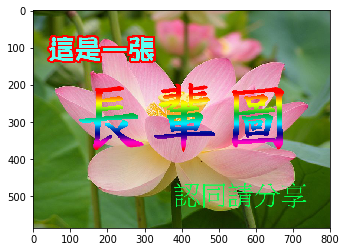

Decoded sentence:  a figurine figurine figurine figurine figurine with a pouch and thread 

-
Input


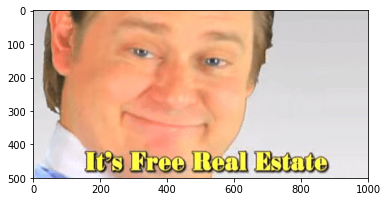

Decoded sentence:  a man is holding a hat in a parking phone 

-
Input


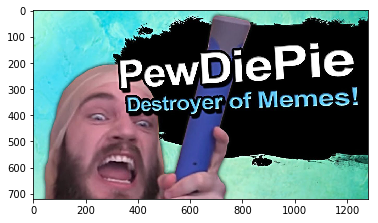

Decoded sentence:  a man is holding a hat with a hat 

-
Input


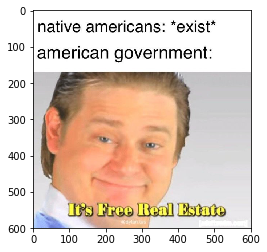

Decoded sentence:  a man is holding a tie in a tie 

-
Input


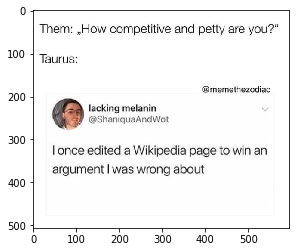

Decoded sentence:  a man is standing on a circle in a circle 

-
Input


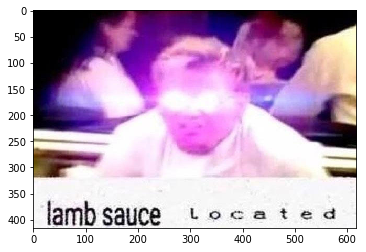

Decoded sentence:  a man is sitting on a table with a laptop 

-
Input


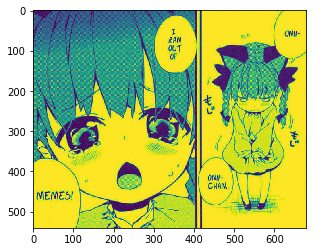

Decoded sentence:  a talented bear posed with a rod and snow 

-
Input


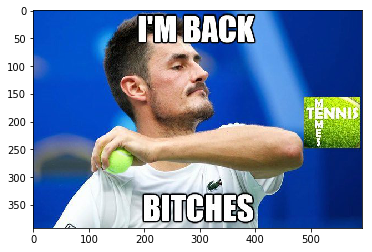

Decoded sentence:  a man is about to hit tennis 

-
Input


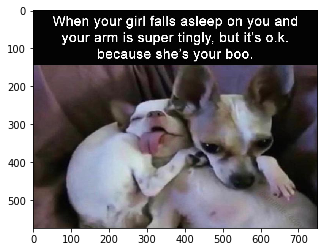

Decoded sentence:  a stock bear sitting in a moped with a moped 

-
Input


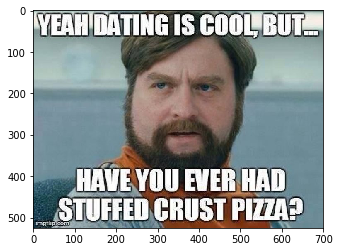

Decoded sentence:  a man wearing a hat in a cellphone 

-
Input


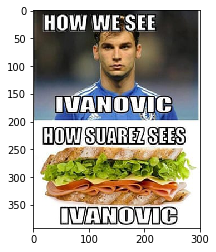

Decoded sentence:  a man with a hot shirt with a hot shirt 

-
Input


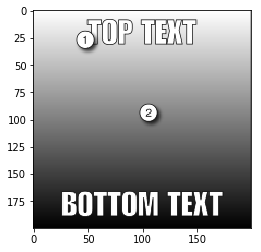

Decoded sentence:  a giraffe is seen in a bridge 

-
Input


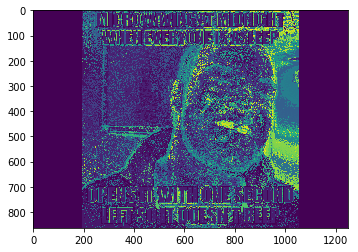

Decoded sentence:  a man wearing a tennis racket in a tennis 

-
Input


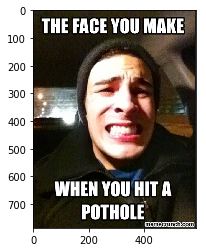

Decoded sentence:  a man wearing a hat and tie 

-
Input


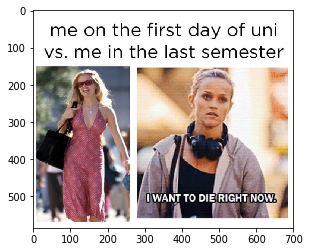

Decoded sentence:  a man wearing a turban in a suit 

-
Input


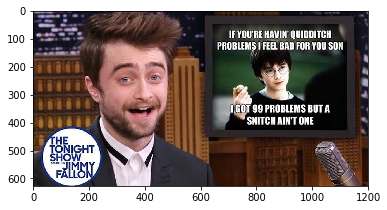

Decoded sentence:  a man is sitting on a store with a kitchen 

-
Input


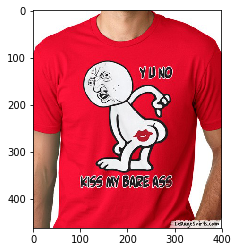

Decoded sentence:  a man in a tennis ball with a cellphone 

-
Input


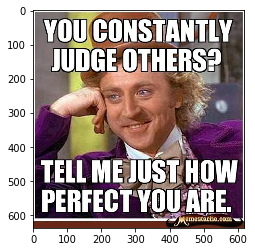

Decoded sentence:  a man wearing a tie in a cell phone 

-
Input


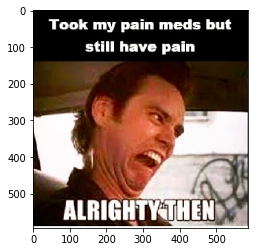

Decoded sentence:  a man wearing a hat is wearing a hat 

-
Input


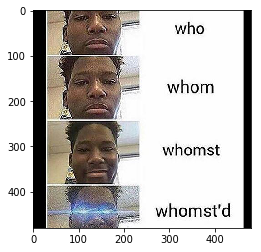

Decoded sentence:  a man is holding a lion is hugging a hat 

-
Input


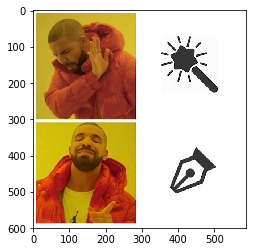

Decoded sentence:  a woman is hugging a teddy bear in a teddy bear 

-
Input


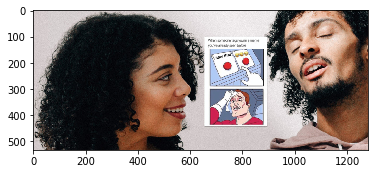

Decoded sentence:  a man holding a cellphone and a cellphone 

-
Input


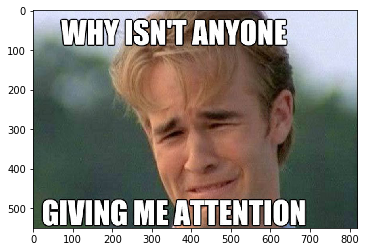

Decoded sentence:  a man is holding a tennis racket on the court 

-
Input


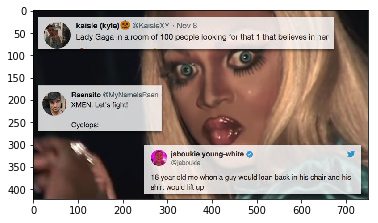

Decoded sentence:  a man is holding a tie in a suit 

-
Input


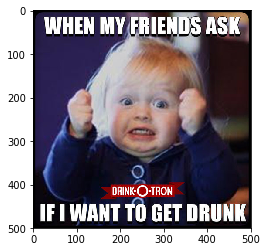

Decoded sentence:  a young girl is holding a hat with a hat 

-
Input


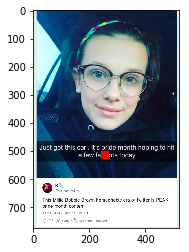

Decoded sentence:  a man in a parasol in a womans phone 

-
Input


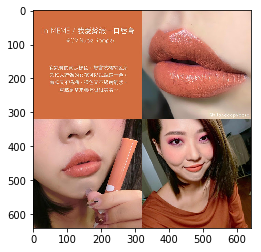

Decoded sentence:  a man is holding a pencil dot smirk with a fourth happily 

-
Input


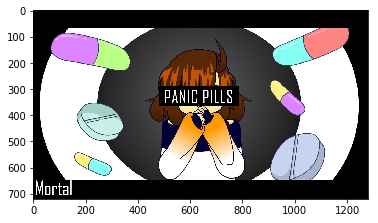

Decoded sentence:  a collage of images with a shadowy ribbon and scissors 

-
Input


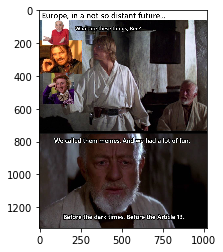

Decoded sentence:  a man in a baseball uniform with a baseball uniform 

-
Input


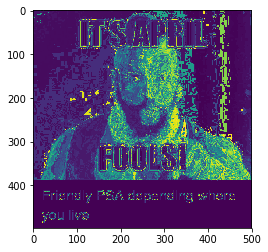

Decoded sentence:  a man wearing a tie in a tie 

-
Input


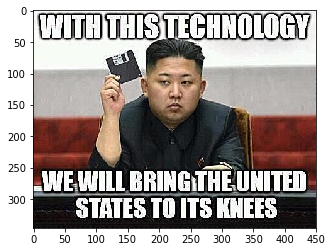

Decoded sentence:  a man wearing a cellphone in front of a store 

-
Input


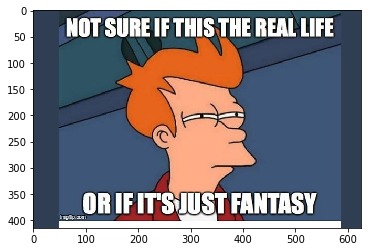

Decoded sentence:  a man is on a street with a street 

-
Input


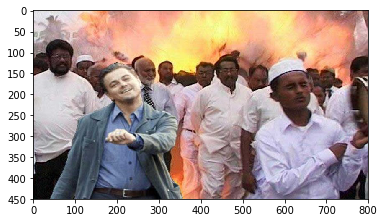

Decoded sentence:  a man is campbell and tie in a room 

-
Input


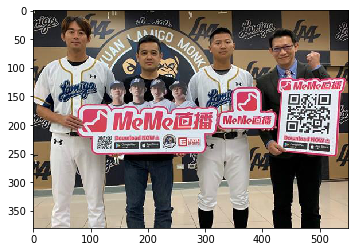

Decoded sentence:  a man arranges a classroom uniform in a building 

-
Input


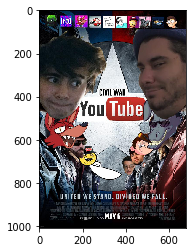

Decoded sentence:  a man wearing a tie in a cell 

-
Input


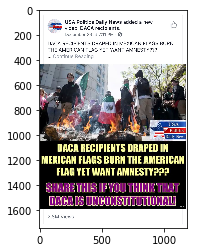

Decoded sentence:  a man is horses in a store 

-
Input


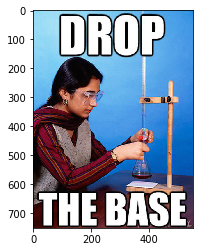

Decoded sentence:  a man is standing on a tennis court 

-
Input


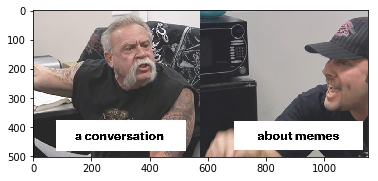

Decoded sentence:  a man is making a cellphone in a cellphone 

-
Input


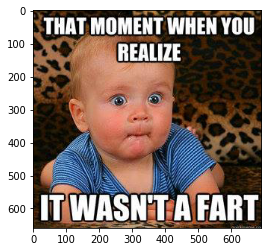

Decoded sentence:  a man laying on a laptop while a laptop and a laptop 

-
Input


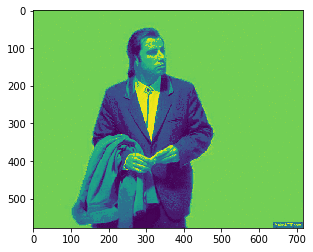

Decoded sentence:  a man wearing a suit and tie in a suit 

-
Input


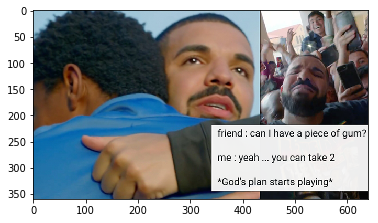

Decoded sentence:  a man is sitting on a body of water 

-
Input


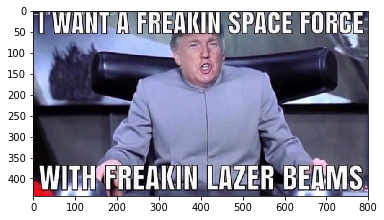

Decoded sentence:  a man wearing a hat with a hat and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a phone
-
Input


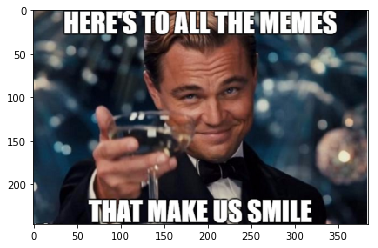

Decoded sentence:  a man wearing a tie and a tie 

-
Input


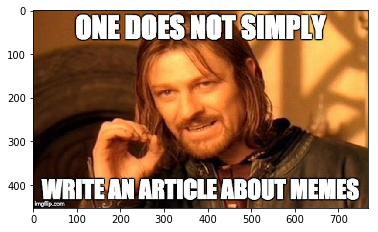

Decoded sentence:  a man is holding a hat with a hat 

-
Input


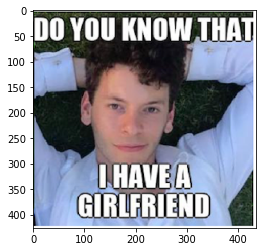

Decoded sentence:  a man is holding a hat with a hat and a hat 

-
Input


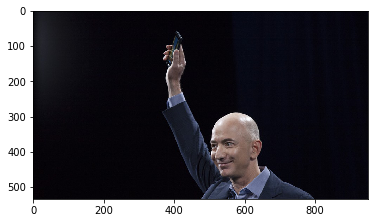

Decoded sentence:  a man is holding a tennis racket and a tennis racket 

-
Input


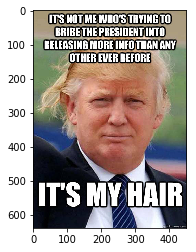

Decoded sentence:  a man wearing a tie and a tie 

-
Input


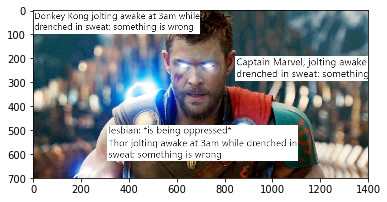

Decoded sentence:  a man is standing on a field with a skateboard 

-
Input


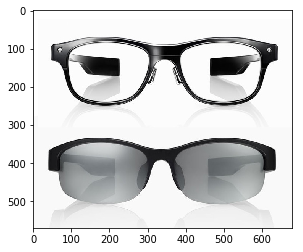

Decoded sentence:  a close up of a frog with a maroon item 

-
Input


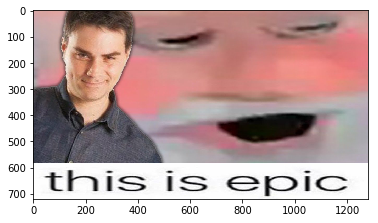

Decoded sentence:  a man is holding a tee shirt and a tee shirt and a man tie 

-
Input


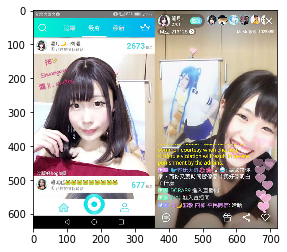

Decoded sentence:  a woman is holding a cellphone in a chair 

-
Input


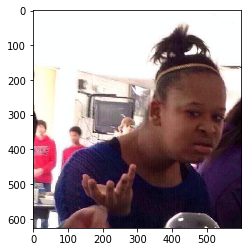

Decoded sentence:  a man is sitting on a fourth with a man and a cake 

-
Input


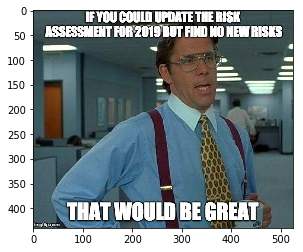

Decoded sentence:  a man is wearing a serious shirt and tie 

-
Input


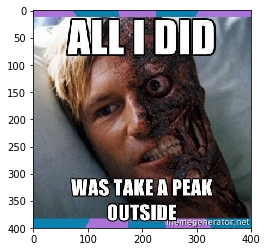

Decoded sentence:  a man wearing a hat with a hat on a cell phone 

-
Input


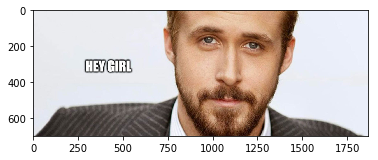

Decoded sentence:  a man is holding a tee shirt and a tennis racket 

-
Input


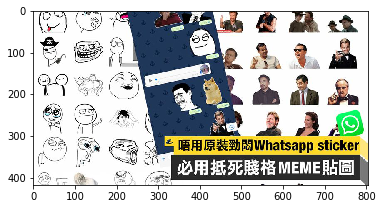

Decoded sentence:  a man is seen in a stage 

-
Input


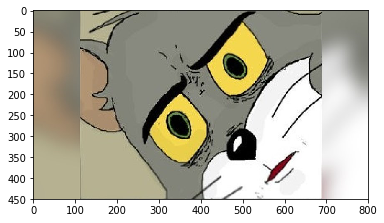

Decoded sentence:  a crane model model model model designs in the background 

-
Input


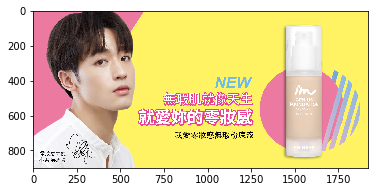

Decoded sentence:  a man is holding a cellphone in a cellphone 

-
Input


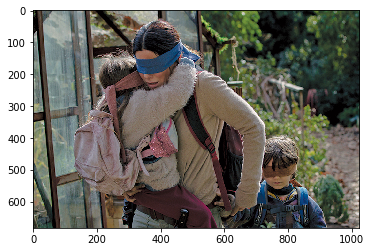

Decoded sentence:  a man is standing on a giraffe bends at a giraffe 

-
Input


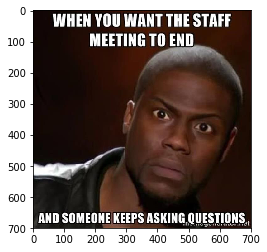

Decoded sentence:  a man wearing a hat and a hat 

-
Input


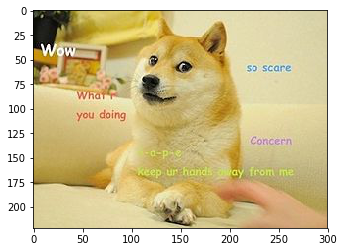

Decoded sentence:  a cat is sitting on a table with a table 

-
Input


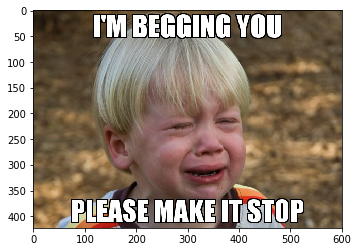

Decoded sentence:  a man wearing a hat in the side of a hat 

-
Input


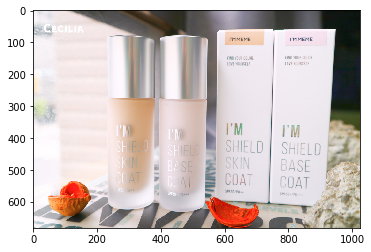

Decoded sentence:  a glass of a white cake in a table 

-
Input


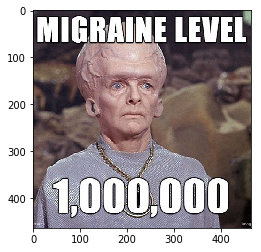

Decoded sentence:  a man is standing on a nest with a skateboard 

-
Input


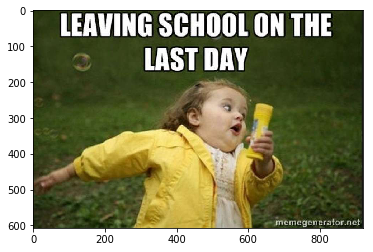

Decoded sentence:  a teenaged boy is holding a skateboard in a second 

-
Input


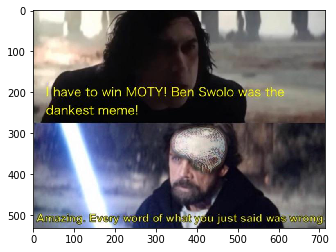

Decoded sentence:  a man wearing a tennis racket in a mirror 

-
Input


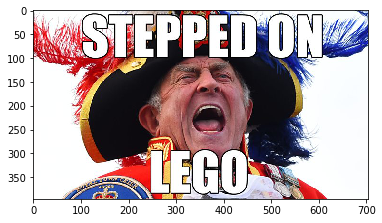

Decoded sentence:  a red sign with a large building 

-
Input


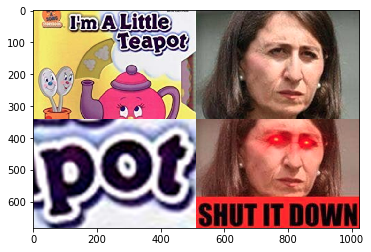

Decoded sentence:  a man is holding a store with a store 

-
Input


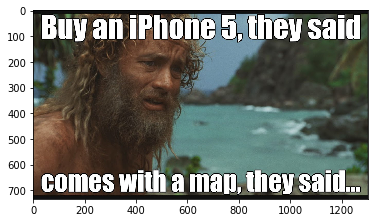

Decoded sentence:  a man is truly smells touches a forrest 

-
Input


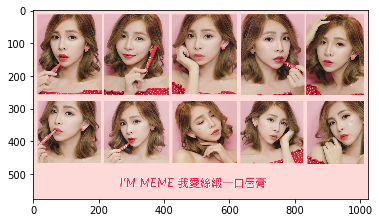

Decoded sentence:  a group of people in a circle in a crowded 

-
Input


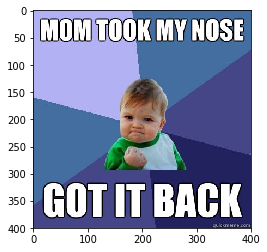

Decoded sentence:  a man is holding a hat with a hat on a bed 

-
Input


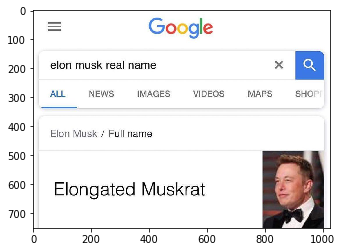

Decoded sentence:  a man is a skateboard in a skateboard 

-
Input


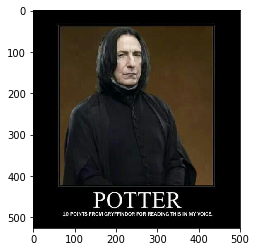

Decoded sentence:  a man is wearing a parasol in a park 

-
Input


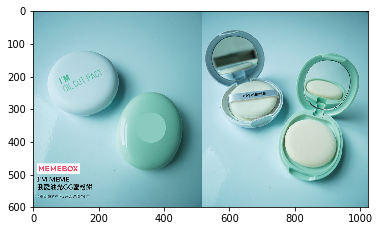

Decoded sentence:  a pair of craft a ruler system and a ruler 

-
Input


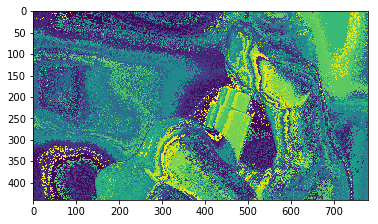

Decoded sentence:  a man is holding a banana in a hat 

-
Input


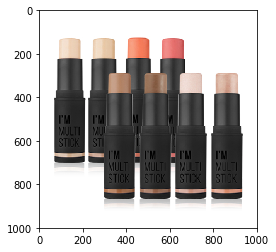

Decoded sentence:  a candy item on a guitar marked and scissors 

-
Input


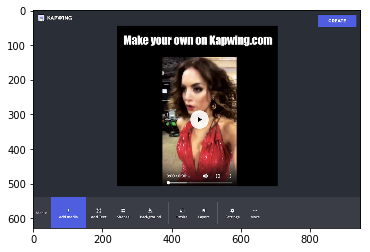

Decoded sentence:  a man is holding a tennis racket in a man 

-
Input


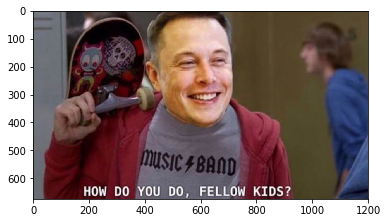

Decoded sentence:  a woman is holding a cellphone in a cellphone 

-
Input


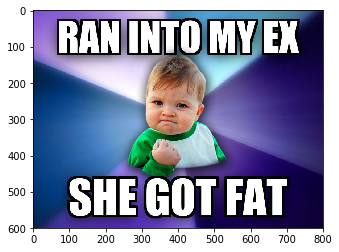

Decoded sentence:  a man is sitting on a cell phone 

-
Input


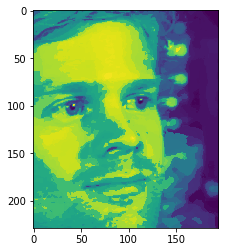

Decoded sentence:  a man is holding a ponytail and tie 

-
Input


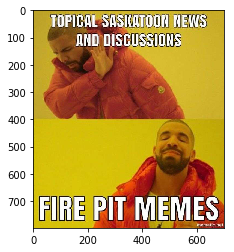

Decoded sentence:  a man wearing a hat with a hat on a cellphone 

-
Input


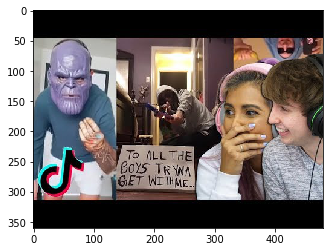

Decoded sentence:  a man is standing in a room with a tie 

-
Input


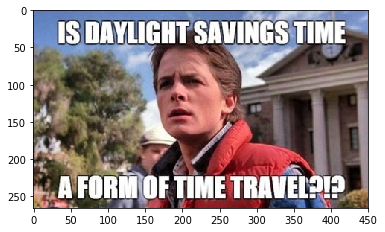

Decoded sentence:  a man is standing on a stage with a stage 

-
Input


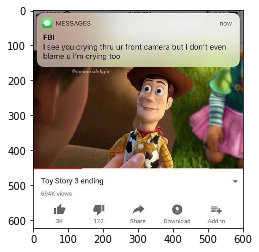

Decoded sentence:  a man is holding a skateboard in a skateboard 

-
Input


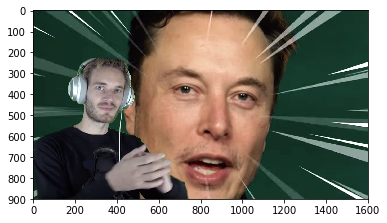

Decoded sentence:  a man is holding a tennis racket on a cellphone 

-
Input


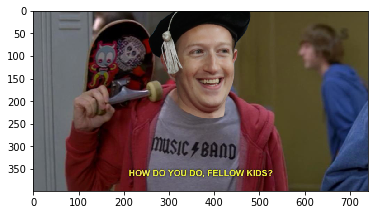

Decoded sentence:  a woman is in a vespa with a vespa 

-
Input


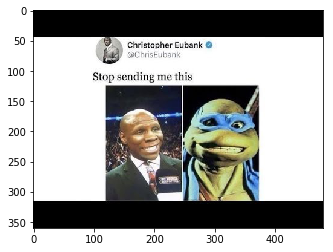

Decoded sentence:  a man with a trick on a tennis 

-
Input


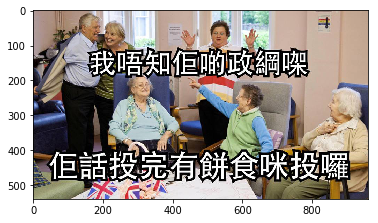

Decoded sentence:  a group of people sitting on a table with a table 

-
Input


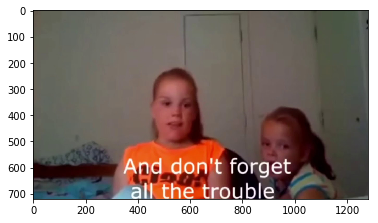

Decoded sentence:  a man is holding a hat control in the camera 

-
Input


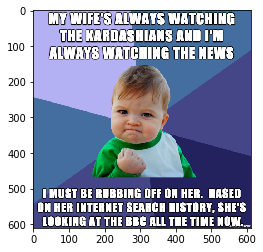

Decoded sentence:  a man wearing a book in front lower a book 

-
Input


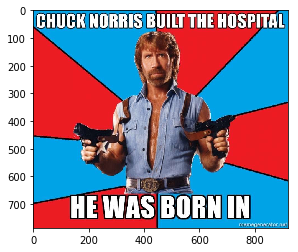

Decoded sentence:  a man is on a street with a street 

-
Input


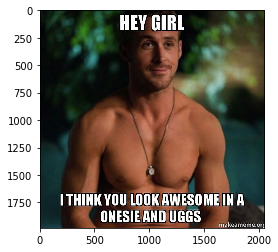

Decoded sentence:  a man is playing a tennis racket 

-
Input


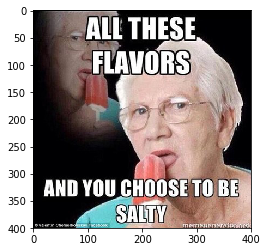

Decoded sentence:  a man is wearing a hat is holding a hat 

-
Input


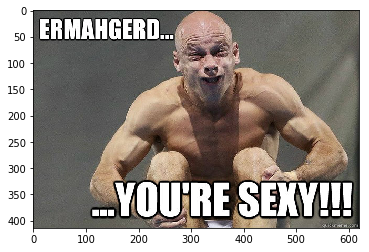

Decoded sentence:  a man is standing on a teddy bear 

-
Input


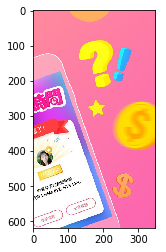

Decoded sentence:  a sizzor bear hugging a celebratory glow and nivea meals 

-
Input


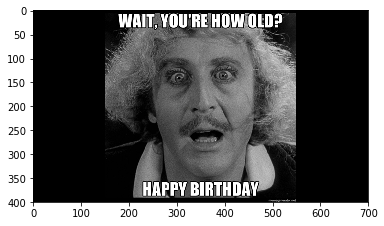

Decoded sentence:  a man is holding a tennis hat in a tennis 

-
Input


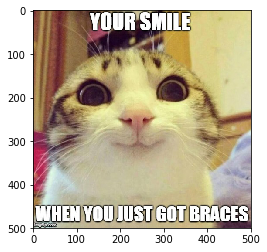

Decoded sentence:  a cat sitting on a chair with a chair 

-
Input


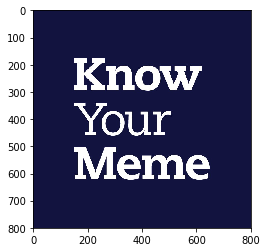

Decoded sentence:  a stop sign is on a asphalt street 

-
Input


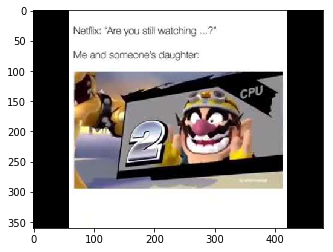

Decoded sentence:  a teddy bear sitting on a stage in a thrift court 

-
Input


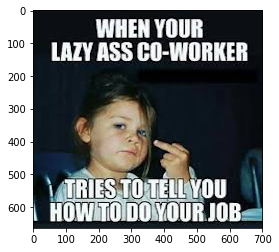

Decoded sentence:  a man is holding a hat with a hat in a man 

-
Input


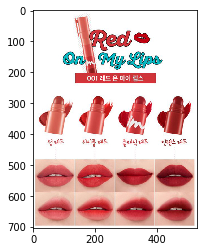

Decoded sentence:  a figurine designed ribbon with a table on a table 

-
Input


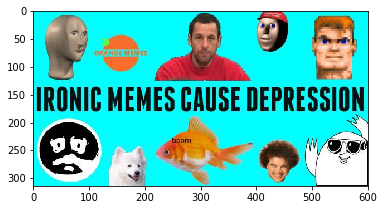

Decoded sentence:  a group of people in a bunch of umbrellas 

-
Input


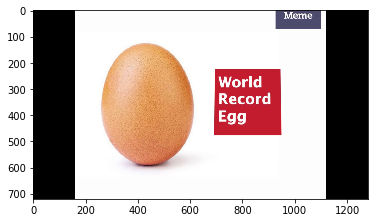

Decoded sentence:  a close up of a apple closed in a bun 

-
Input


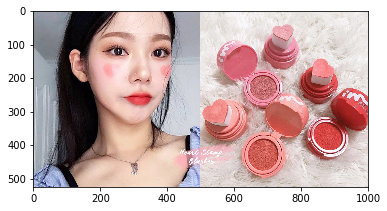

Decoded sentence:  a close up of a purse and a glass and a glass 

-
Input


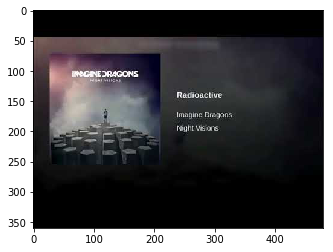

Decoded sentence:  a baseball clay clay clay is on a court 

-
Input


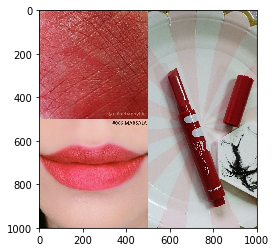

Decoded sentence:  a cake with a keboard on a table 

-
Input


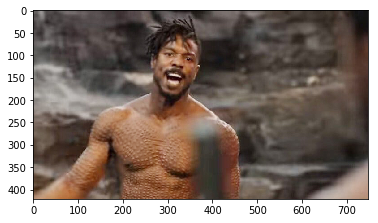

Decoded sentence:  a man is sitting on a sidecar flops feet 

-
Input


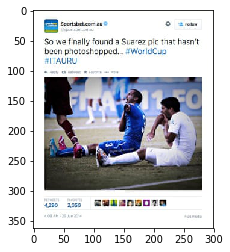

Decoded sentence:  a man is performing a trick in front of a ramp 

-
Input


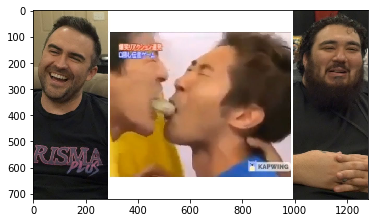

Decoded sentence:  a man holding a tennis racket in a tennis racket 

-
Input


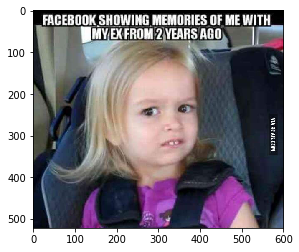

Decoded sentence:  a man is holding a turban on a shadowy hoop 

-
Input


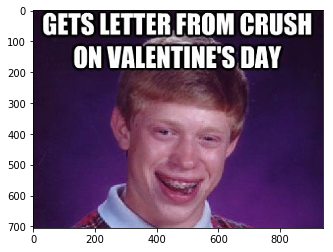

Decoded sentence:  a man wearing a tie in a suit 

-
Input


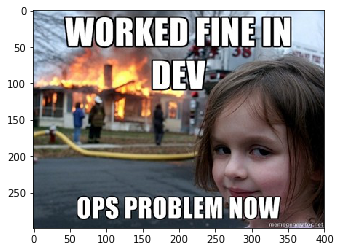

Decoded sentence:  a man is standing on a street with a street 

-
Input


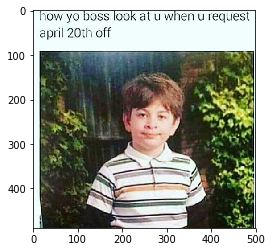

Decoded sentence:  a man is sitting on a chair with a man and protect a man and protect a man and protect a man and protect a man and a man and a umbrella 

-
Input


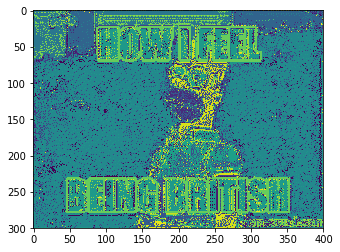

Decoded sentence:  a figurine angle with a damaged hospital 

-
Input


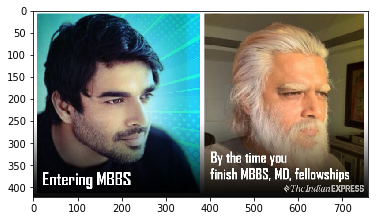

Decoded sentence:  a man is holding a hat with a hat 

-
Input


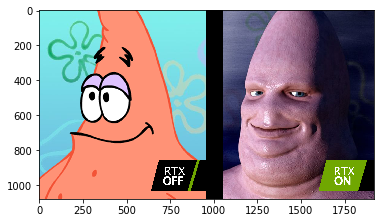

Decoded sentence:  a close up of a polka shirt and a shadowy bag 

-
Input


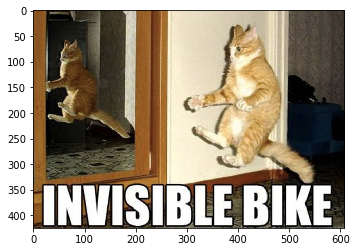

Decoded sentence:  a cat sitting on a car with a car 

-
Input


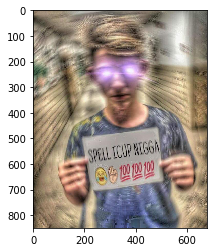

Decoded sentence:  a man is smoking shirt in a room 

-
Input


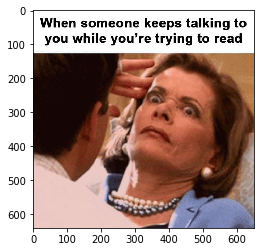

Decoded sentence:  a man is holding a hat and a hat and scissors 

-
Input


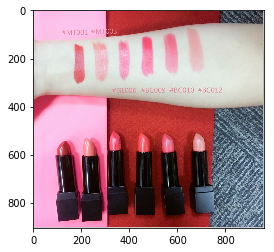

Decoded sentence:  a collage of scissors on a table with a table 

-
Input


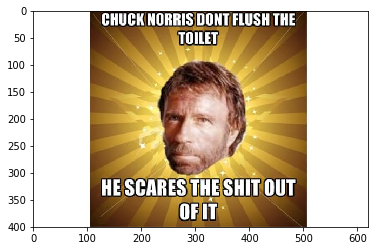

Decoded sentence:  a man is standing in a ledge of a closet 

-
Input


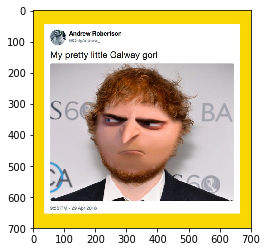

Decoded sentence:  a man is standing in a nest with a hat 

-
Input


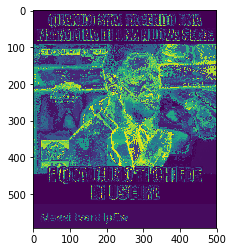

Decoded sentence:  a man wearing a tie in a shirt 

-
Input


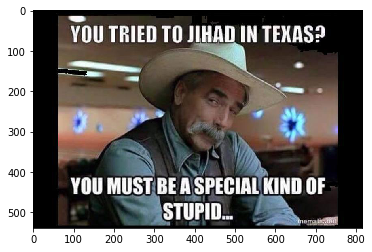

Decoded sentence:  a man is wearing a hat and a cellphone 

-
Input


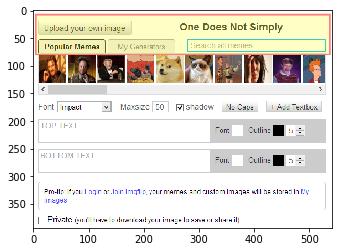

Decoded sentence:  a group of people are standing on a stage 

-
Input


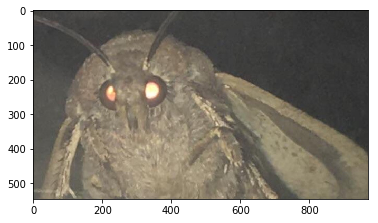

Decoded sentence:  a close up of a parrot contraption with a perch 

-
Input


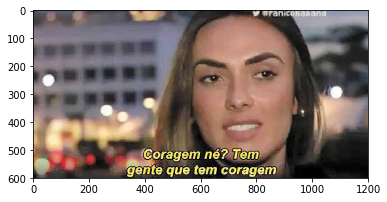

Decoded sentence:  a man is sitting on a street begs 

-
Input


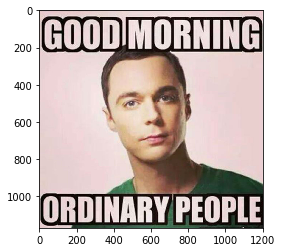

Decoded sentence:  a man is holding a tee dot dot smirk in a creepy boddy 

-
Input


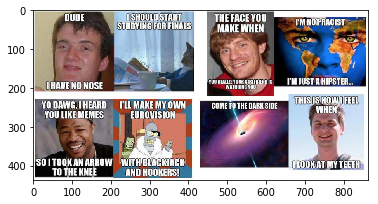

Decoded sentence:  a man is holding a turban in a stage 

-
Input


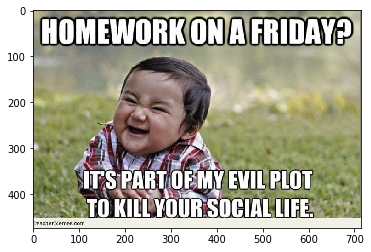

Decoded sentence:  a man is standing in front of a bottle of reach head 

-
Input


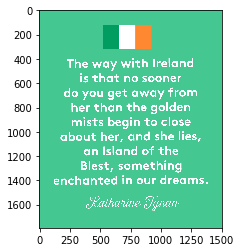

Decoded sentence:  a figurine and a cellphone in a bridge 

-
Input


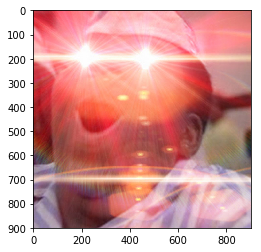

Decoded sentence:  a man is posed in a bow hat 

-
Input


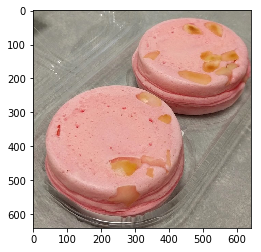

Decoded sentence:  a cake with a banana and a banana and coffee cake 

-
Input


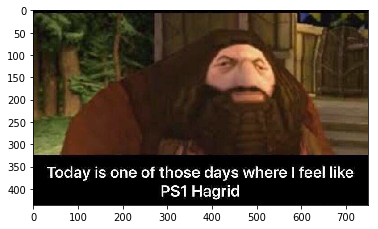

Decoded sentence:  a man is sitting on a vespa with a ledge 

-
Input


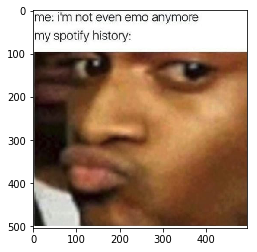

Decoded sentence:  a man holding a hat with a hat in a hat 

-
Input


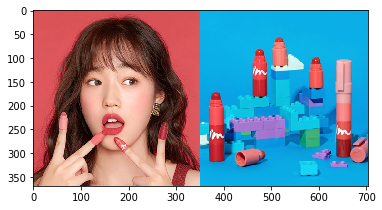

Decoded sentence:  a man in a crowded umbrella on stage 

-
Input


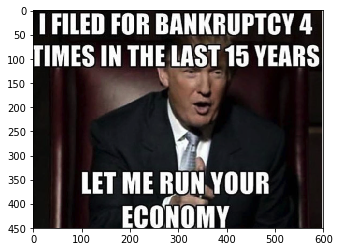

Decoded sentence:  a man wearing a hat with a hat on a building 

-
Input


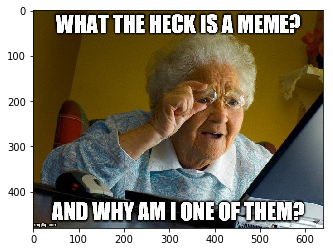

Decoded sentence:  a man wearing a tie in a tie 

-
Input


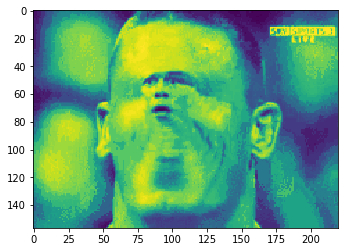

Decoded sentence:  a man is holding a hat with a hat in the camera 

-
Input


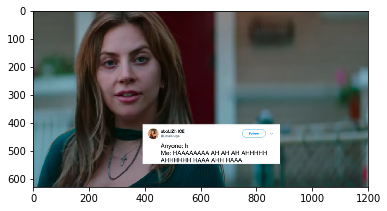

Decoded sentence:  a man is drunk shirt on a cellphone 

-
Input


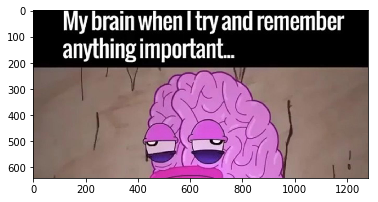

Decoded sentence:  a teddy bear is posed in a shadowy restroom 

-
Input


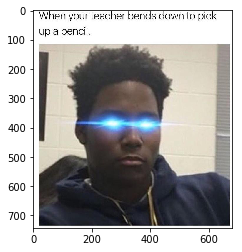

Decoded sentence:  a man wearing a hat and a hat 

-
Input


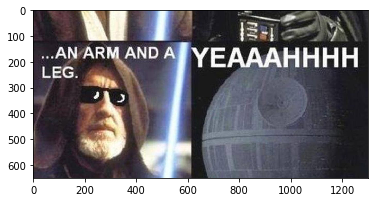

Decoded sentence:  a hello shirt bear in a car 

-
Input


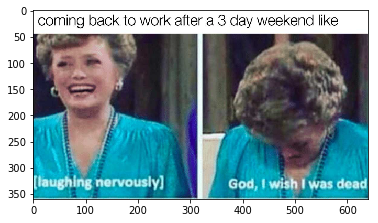

Decoded sentence:  a man wearing a tie in a tie 

-
Input


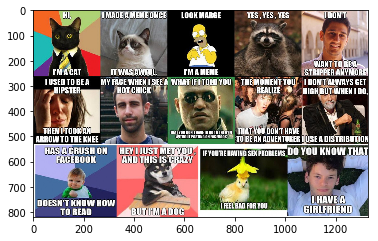

Decoded sentence:  a man with a creepy companions companions companions companions with a creepy 

-
Input


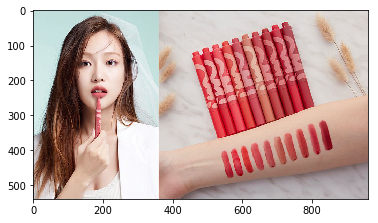

Decoded sentence:  a man is sitting on a bed with a bed 

-
Input


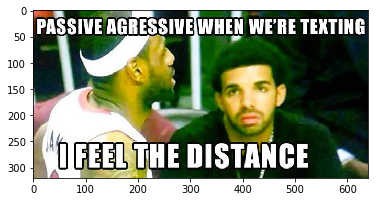

Decoded sentence:  a man is holding a tennis racket in a tennis 

-
Input


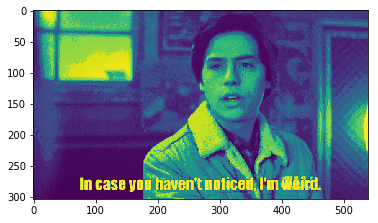

Decoded sentence:  a man is wearing a serious shirt and a bowler 

-
Input


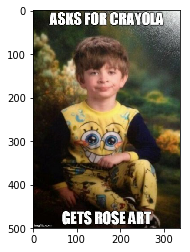

Decoded sentence:  a man is sitting on a teddy bear 

-
Input


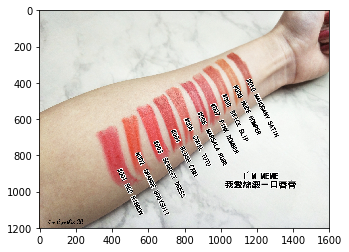

Decoded sentence:  a man is much a parrot and scissors 

-
Input


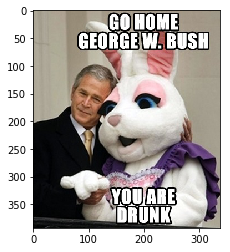

Decoded sentence:  a man is sitting on a doughnut in a car 

-
Input


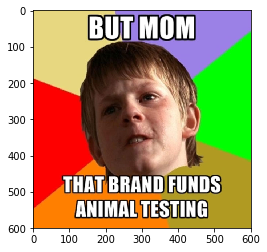

Decoded sentence:  a man is holding a cellphone on a tennis 

-
Input


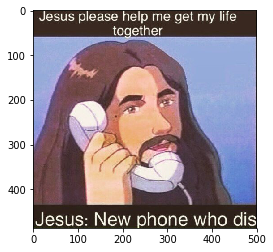

Decoded sentence:  a man is hugging a tie in a hat 

-
Input


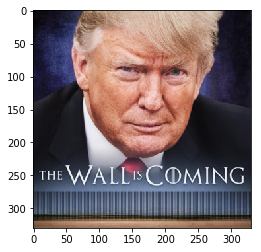

Decoded sentence:  a man wearing a tie and a tie 

-
Input


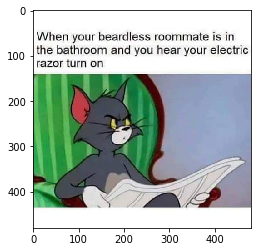

Decoded sentence:  a figurine figurine figurine figurine with a trick on a moped 

-
Input


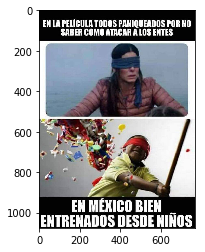

Decoded sentence:  a man is skiers on a slope with a slope 

-
Input


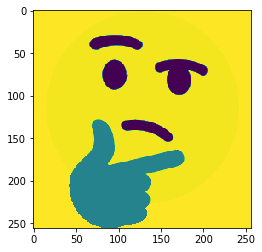

Decoded sentence:  a close up of a bird sitting on a workbook 

-
Input


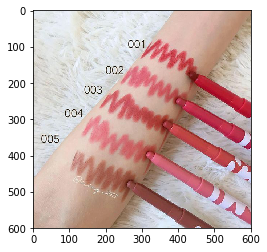

Decoded sentence:  a pocket bear sitting on a puddle with a puddle 

-
Input


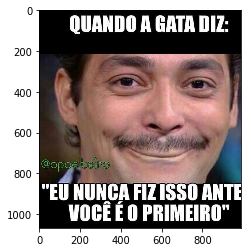

Decoded sentence:  a man wearing a tennis hat and tie 

-
Input


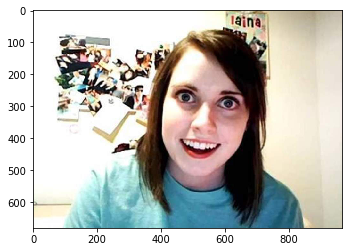

Decoded sentence:  a man is holding underclothes and underclothes and aloft regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions regions
-
Input


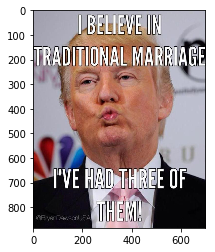

Decoded sentence:  a man wearing a tie in a suit 

-
Input


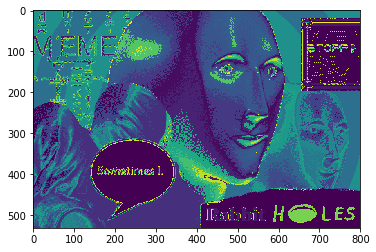

Decoded sentence:  a man is holding a tennis racket on a tennis 

-
Input


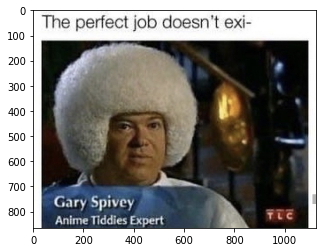

Decoded sentence:  a man wearing a hat is wearing a hat 

-
Input


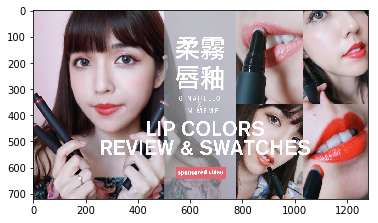

Decoded sentence:  a man holding a pair of styles on a table 

-
Input


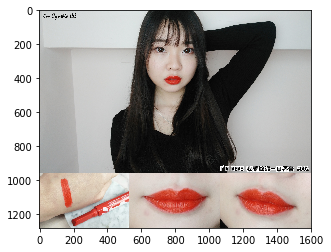

Decoded sentence:  a man is holding a man in a cell 

-
Input


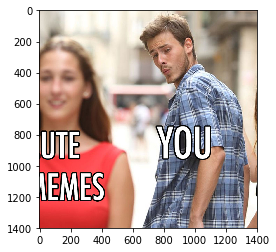

Decoded sentence:  a man is standing in front of a baseball uniform 

-
Input


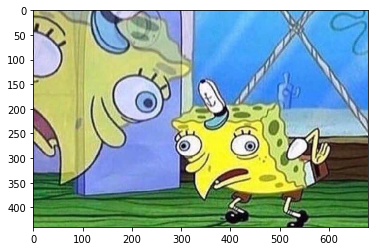

Decoded sentence:  a refridgerator states and scissors on a perch 

-
Input


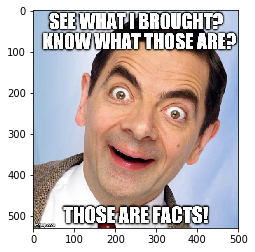

Decoded sentence:  a man wearing a tie in a tie 

-
Input


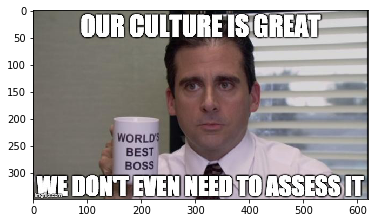

Decoded sentence:  a man is holding a tie with a serious blocking a man 

-
Input


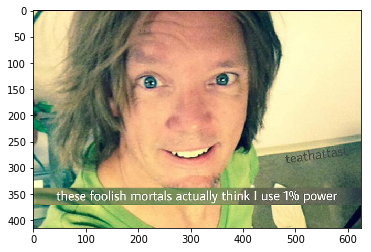

Decoded sentence:  a man wearing a cellphone in a cellphone 

-
Input


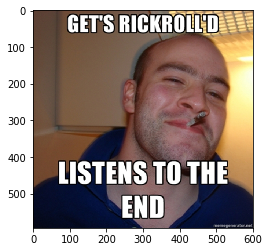

Decoded sentence:  a man wearing a hat is wearing a hat 

-
Input


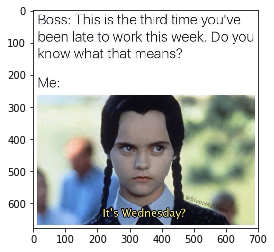

Decoded sentence:  a man wearing a tie in a tie 

-
Input


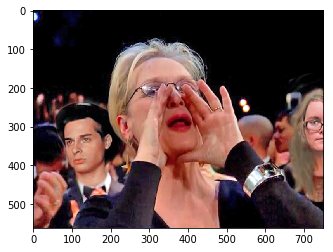

Decoded sentence:  a man in a suit in a suit 

-
Input


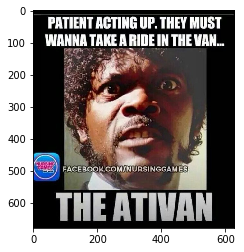

Decoded sentence:  a man is wearing a tennis racket with a tennis racket 

-
Input


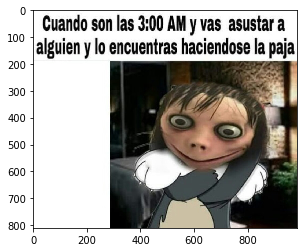

Decoded sentence:  a man is holding a cellphone in a cellphone 

-
Input


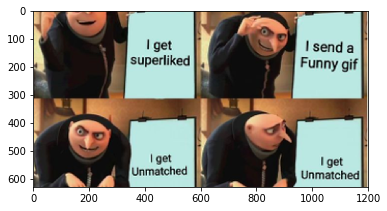

Decoded sentence:  a woman is holding a cellphone in a cellphone 

-
Input


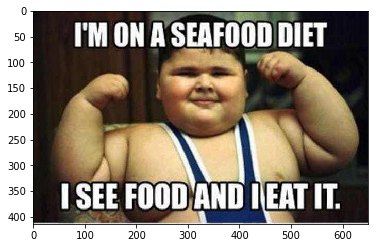

Decoded sentence:  a man wearing a skateboard in a skateboard 

-
Input


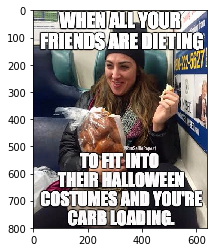

Decoded sentence:  a man is wearing a suit in a suit 

-
Input


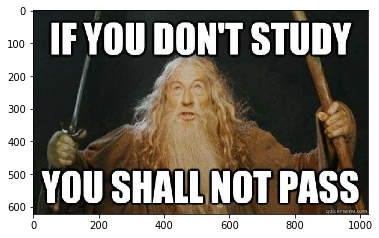

Decoded sentence:  a man is standing in a street with a street 

-
Input


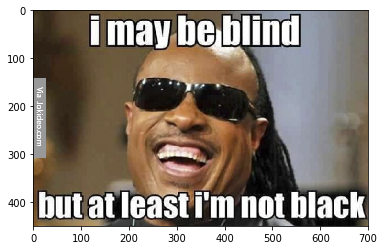

Decoded sentence:  a man is holding a shirt shirt and a shirt and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man 

-
Input


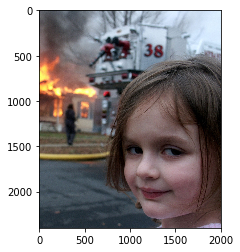

Decoded sentence:  a man is holding a skateboard in a leash 

-
Input


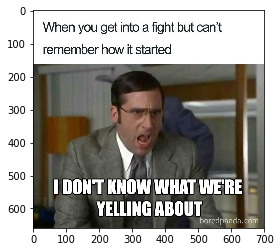

Decoded sentence:  a man in a suit and tie in the kitchen 

-
Input


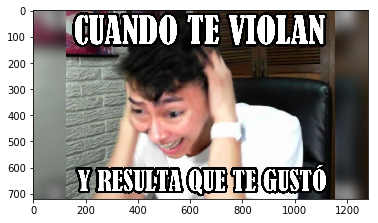

Decoded sentence:  a man is in a skateboard in a street 

-
Input


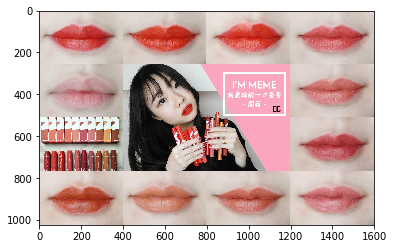

Decoded sentence:  a teddy bear is on a table with a purple chair 

-
Input


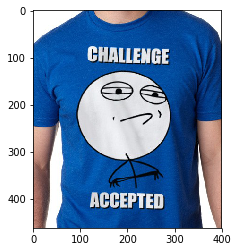

Decoded sentence:  a man in a poster with a poster 

-
Input


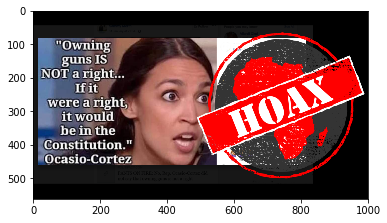

Decoded sentence:  a man speeding in a street with a street sign 

-
Input


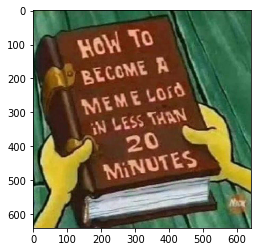

Decoded sentence:  a stop sign with a street sign on a street 

-
Input


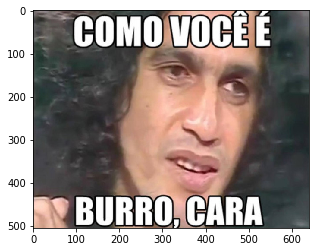

Decoded sentence:  a man is wearing a hat is holding a hat 

-
Input


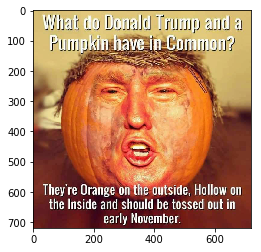

Decoded sentence:  a man is standing on a tennis court 

-
Input


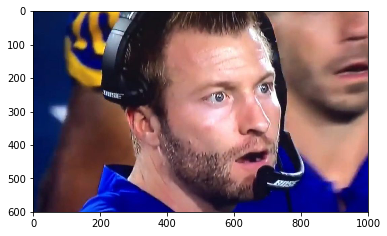

Decoded sentence:  a man holding a tennis racket in the air 

-
Input


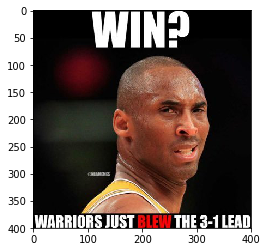

Decoded sentence:  a man is wearing a tennis racket in a tennis 

-
Input


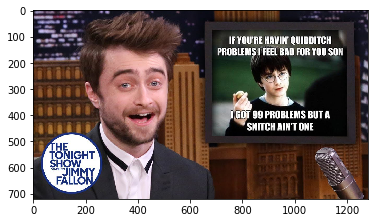

Decoded sentence:  a man is standing in front of a kitchen 

-
Input


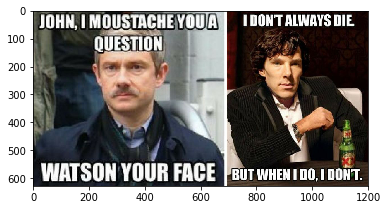

Decoded sentence:  a man is standing at a bottle of men 

-
Input


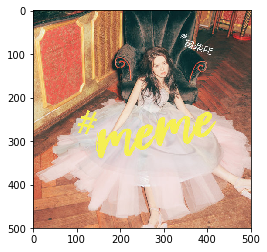

Decoded sentence:  a man is sitting on a bench with a bench 

-
Input


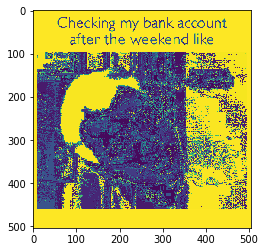

Decoded sentence:  a man is holding a hat with a hat 

-
Input


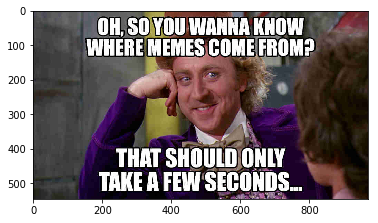

Decoded sentence:  a man wearing a suit and tie in a suit 

-
Input


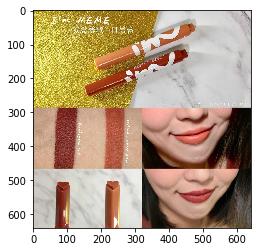

Decoded sentence:  a man is holding a pencil and a pencil donut 

-
Input


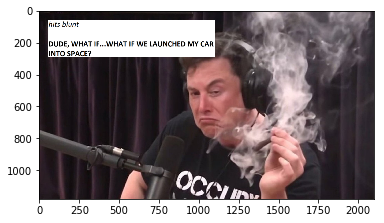

Decoded sentence:  a man is standing on a skateboard in a park 

-
Input


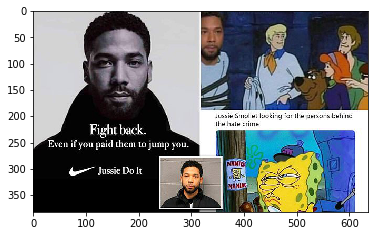

Decoded sentence:  a man is posed in a crowded 

-
Input


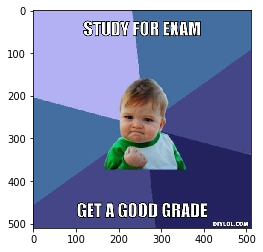

Decoded sentence:  a man is holding a tee shirt and shin cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs cuffs and scissors 

-
Input


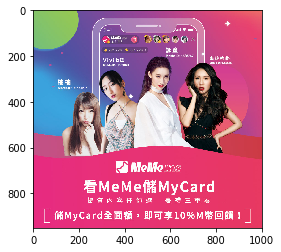

Decoded sentence:  a woman in a video game with a video game 

-
Input


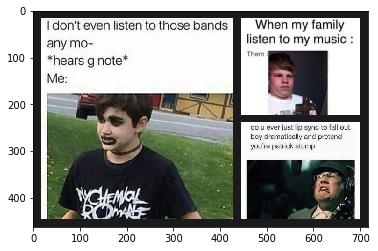

Decoded sentence:  a man wearing a skateboard in a tennis 

-
Input


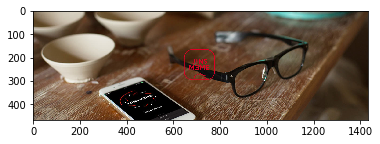

Decoded sentence:  a desktop with a keyboard and a keyboard 

-
Input


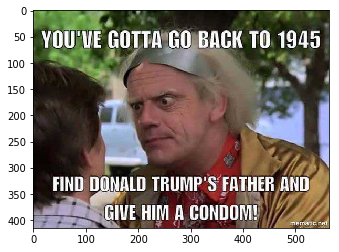

Decoded sentence:  a man is wearing a tie with a tie 

-
Input


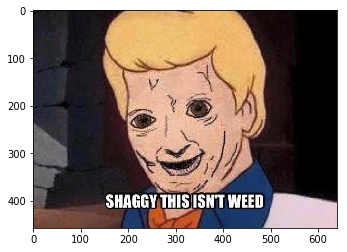

Decoded sentence:  a man is holding a plaid plaid plaid plaid plaid plaid plaid satin racket 

-
Input


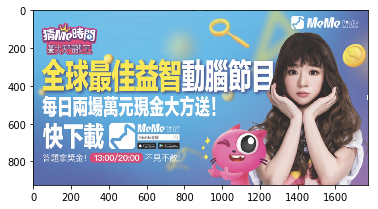

Decoded sentence:  a man is holding a tennis racket on a tennis court 

-
Input


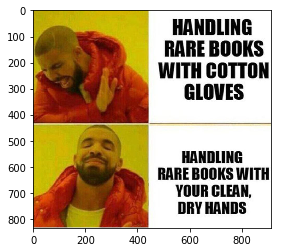

Decoded sentence:  a woman is holding a banana on a bun 

-
Input


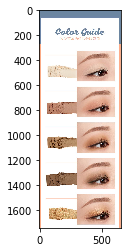

Decoded sentence:  images of instructor beam kernel kernel kernel on a creepy 

-
Input


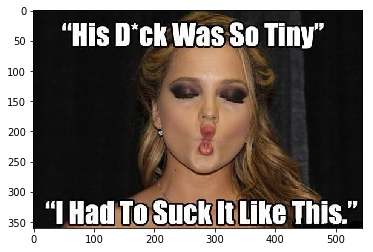

Decoded sentence:  a man holding a hat with a hat 

-
Input


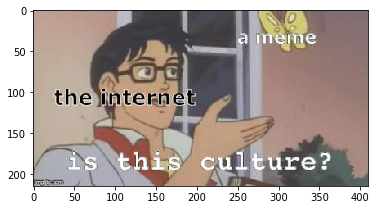

Decoded sentence:  a man is holding a pair of shin 

-
Input


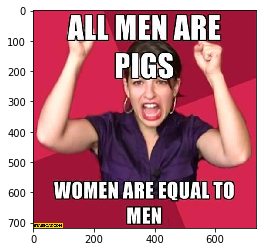

Decoded sentence:  a man is standing on a street with a cell phone 

-
Input


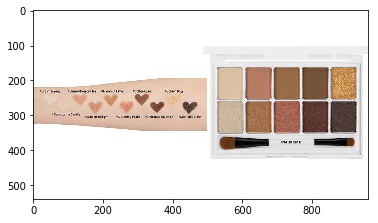

Decoded sentence:  a oil and makeup images of a ruler beam 

-
Input


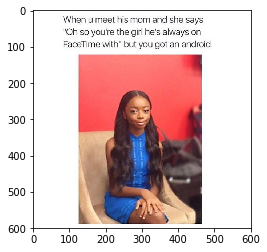

Decoded sentence:  a man wearing a tie in a tie 

-
Input


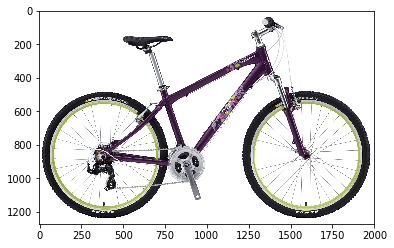

Decoded sentence:  a bike sitting on a bike near a building 

-
Input


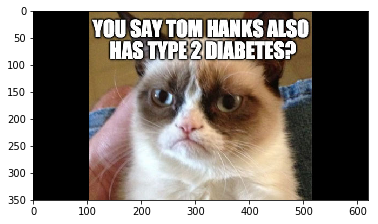

Decoded sentence:  a cat laying on a chair with a bed 

-
Input


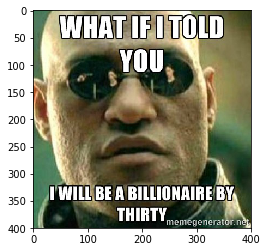

Decoded sentence:  a man wearing a hat with a hat in a mirror 

-
Input


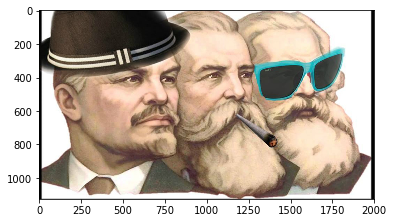

Decoded sentence:  a polka polka polka bear is wearing a kite 

-
Input


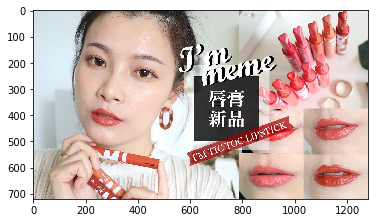

Decoded sentence:  a woman is holding a tee dot smirk with a tee dot phones 

-
Input


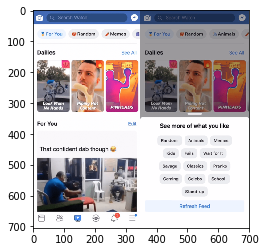

Decoded sentence:  a group of people are are are are are on front of a street 

-
Input


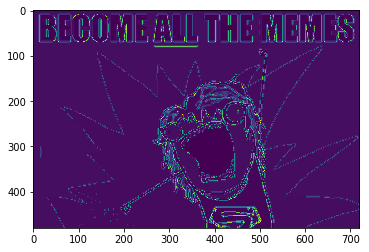

Decoded sentence:  a bicyclist is consist on a pole 

-
Input


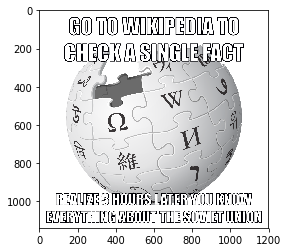

Decoded sentence:  a parrot contraption is sitting on a perch 

-
Input


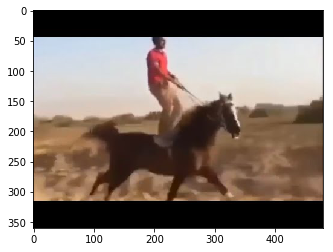

Decoded sentence:  a lifeguards dog is flying a surfboard in the water 

-
Input


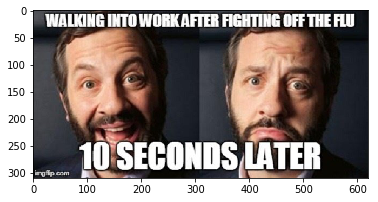

Decoded sentence:  a man is holding a tennis racket on a cellphone 

-
Input


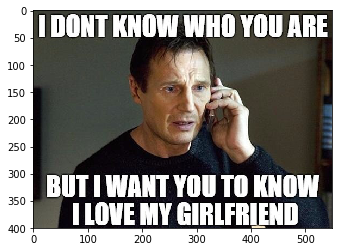

Decoded sentence:  a man wearing a hat with a hat in a car 

-
Input


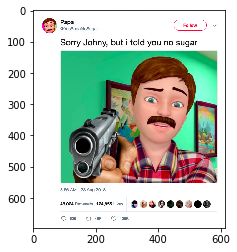

Decoded sentence:  a man holding a tie in a womans 

-
Input


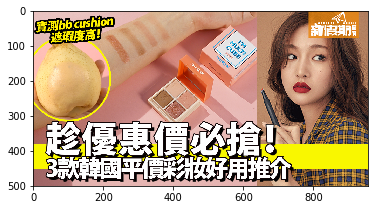

Decoded sentence:  a hello shirt is holding a piece of scissors 

-
Input


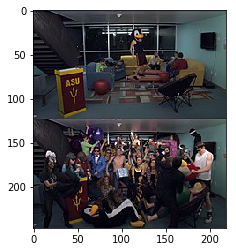

Decoded sentence:  a man standing in a museum with a restroom 

-
Input


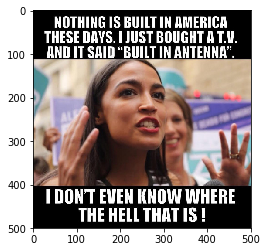

Decoded sentence:  a man is sitting on a cell phone 

-
Input


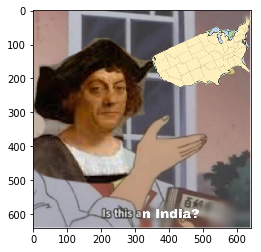

Decoded sentence:  a man is wearing a hat with a hat 

-
Input


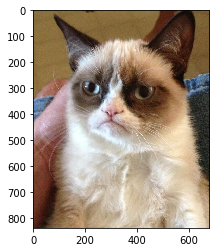

Decoded sentence:  a cat sitting on a bed with a bed 

-
Input


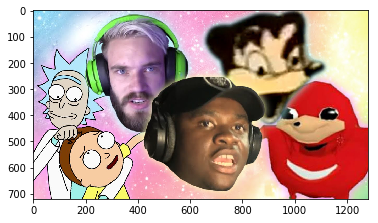

Decoded sentence:  a man is holding a teddy bear and a teddy bear 

-
Input


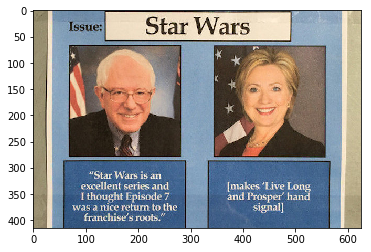

Decoded sentence:  a man wearing a tie and a hat 

-
Input


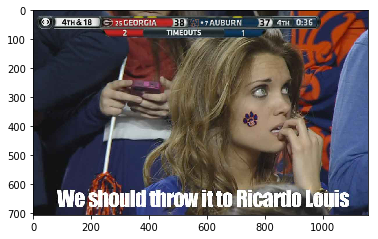

Decoded sentence:  a man is holding a sombrero outfits costume costume in a plaid building 

-
Input


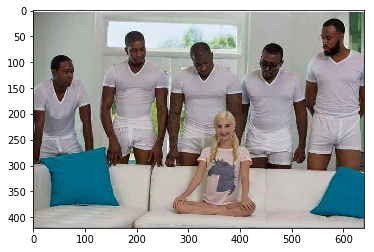

Decoded sentence:  a group of people standing adamantly in a room 

-
Input


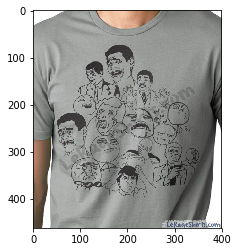

Decoded sentence:  a figurine bear in a stage in a bottle 

-
Input


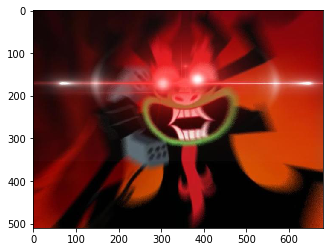

Decoded sentence:  a piece of a toothbrush in a metal lot 

-
Input


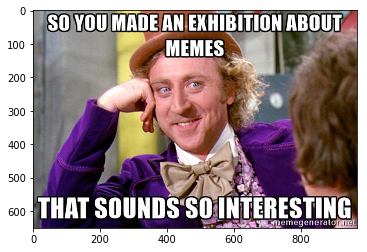

Decoded sentence:  a man wearing a hat and tie 

-
Input


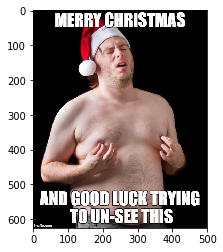

Decoded sentence:  a man is holding a tennis ball in the air 

-
Input


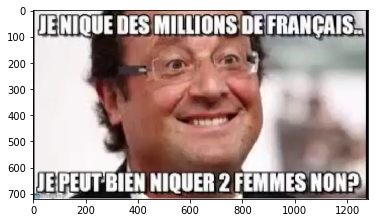

Decoded sentence:  a man is holding a teddy bear and a teddy bear 

-
Input


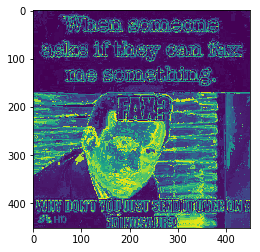

Decoded sentence:  a man is sitting on a podium with a medial vent 

-
Input


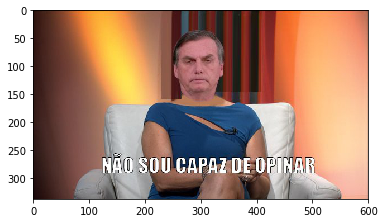

Decoded sentence:  a man sitting on a chair in a bed 

-
Input


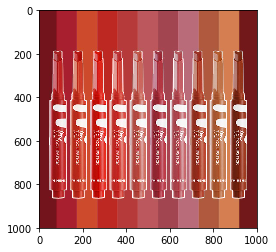

Decoded sentence:  a filmstrip with a pouch glow on a workbook 

-
Input


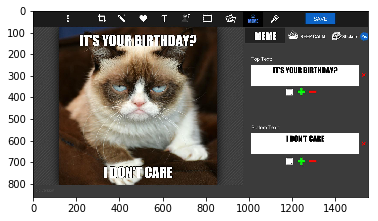

Decoded sentence:  a figurine figurine figurine figurine gives devices 

-
Input


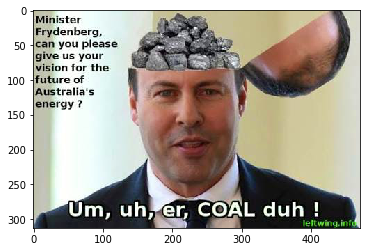

Decoded sentence:  a man wearing a tie and a tie 

-
Input


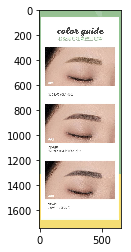

Decoded sentence:  a racer is posed in a rope 

-
Input


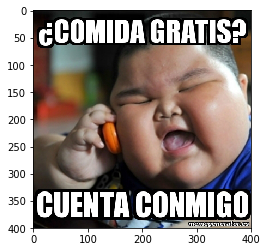

Decoded sentence:  a man holding a banana in a banana 

-
Input


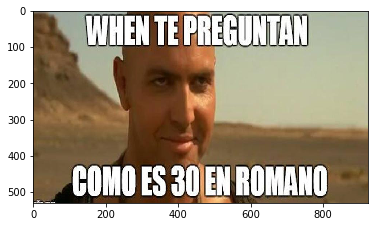

Decoded sentence:  a woman is holding a hat and a hat 

-
Input


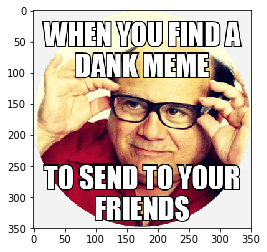

Decoded sentence:  a man wearing a cellphone in a cellphone 

-
Input


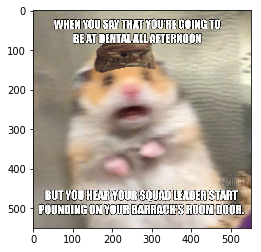

Decoded sentence:  a dog is seem in a banana 

-
Input


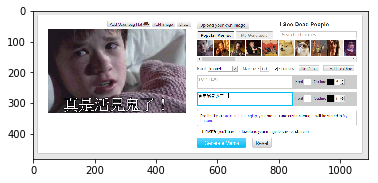

Decoded sentence:  a figurine bear performing a stage in a stage 

-
Input


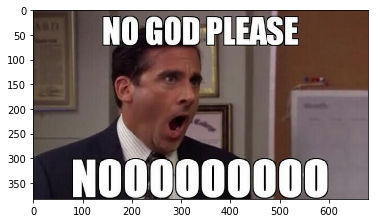

Decoded sentence:  a man is holding a cellphone in a kitchen 

-
Input


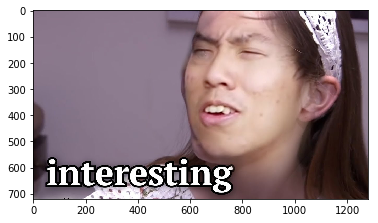

Decoded sentence:  a man is holding a hat with a hat and a hat 

-
Input


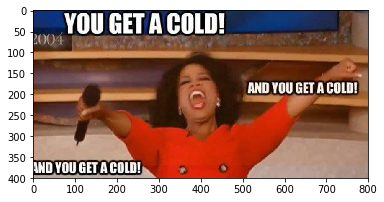

Decoded sentence:  a man figurine is on a street with a skateboard 

-
Input


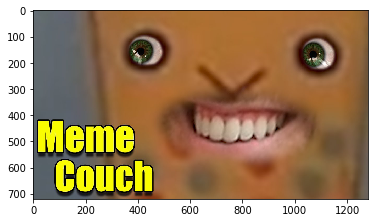

Decoded sentence:  a pair of a ruler and a chain and a ruler game 

-
Input


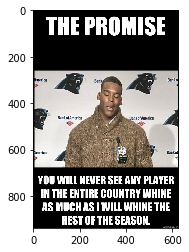

Decoded sentence:  a man is standing on a leopard shirt and a tub 

-
Input


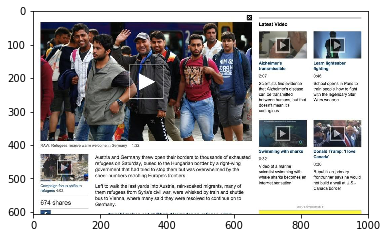

Decoded sentence:  a man in a train departure departure beams 

-
Input


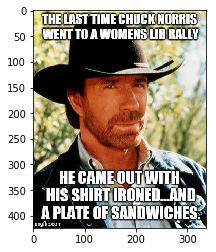

Decoded sentence:  a man wearing a hat and a hat 

-
Input


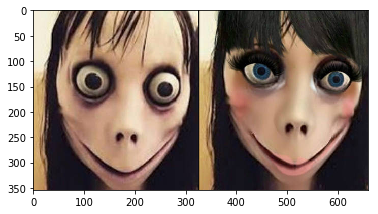

Decoded sentence:  a teddy bear is posed in a store 

-
Input


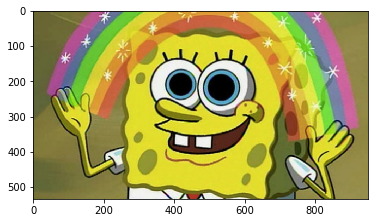

Decoded sentence:  a close up of a flower and a bunch of bananas 

-
Input


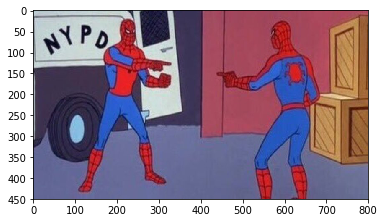

Decoded sentence:  a view of a department and a circle on a circle 

-
Input


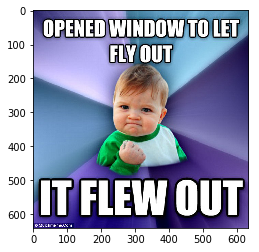

Decoded sentence:  a man is holding a human tie in a car 

-
Input


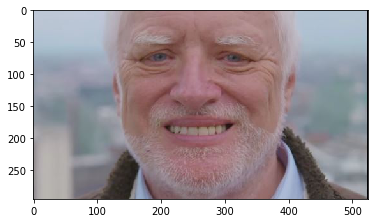

Decoded sentence:  a man is holding a button shirt is holding a button ear 

-
Input


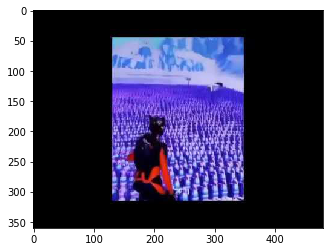

Decoded sentence:  a man is raking a nearly shirt played on the snow 

-
Input


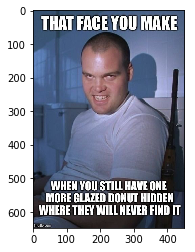

Decoded sentence:  a man is wearing a vehicle with a car 

-
Input


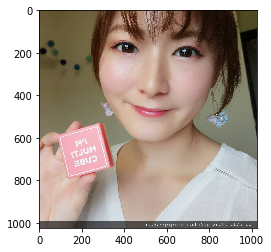

Decoded sentence:  a oman is holding a pencil expression and a pencil game 

-
Input


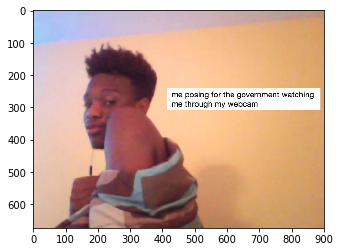

Decoded sentence:  a man wearing a toothbrush and a toothbrush 

-
Input


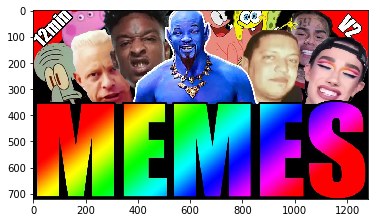

Decoded sentence:  a man is tying a shadowy shirt and a circle 

-
Input


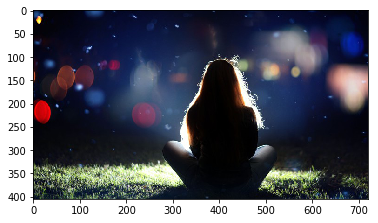

Decoded sentence:  a man is flying a kite in a kite 

-
Input


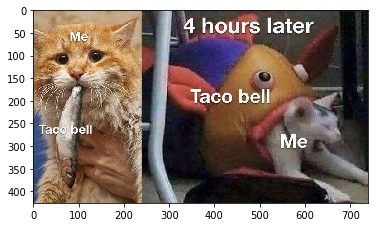

Decoded sentence:  a cat sitting on a car dashboard in a car 

-
Input


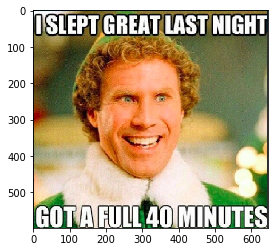

Decoded sentence:  a man wearing a tie in a tie 

-
Input


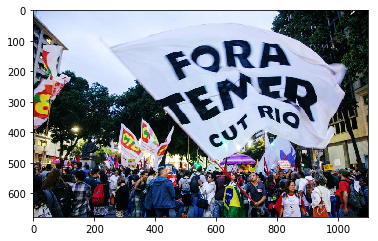

Decoded sentence:  a group of people congregating in a store 

-
Input


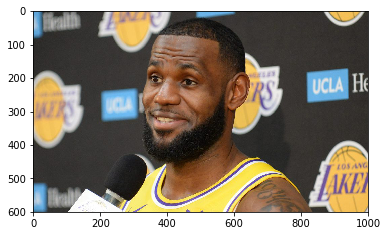

Decoded sentence:  a man wearing a hat with a hat and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a man and a apple 

-
Input


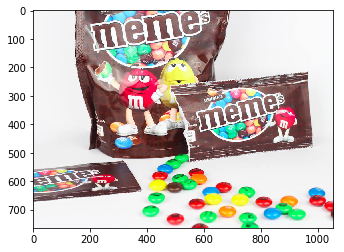

Decoded sentence:  a figurine and scissors sitting on a table 

-
Input


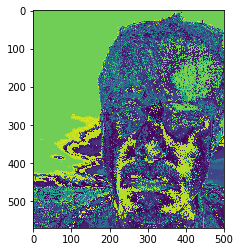

Decoded sentence:  a man is holding a fourth in a necklace 



IsADirectoryError: [Errno 21] Is a directory: 'file/.ipynb_checkpoints'

In [14]:
for f in os.listdir('file'):
    if 'zip' not in f:
        code=vggextract('file/'+f)
        code=np.reshape(code,(1,code.shape[0]))
        did=np.zeros(
            (seq_len),dtype='float32'
        )
        did=np.reshape(did,(1,did.shape[0]))
        did[0][0]=float(token['\t'])
        sentence=decode(code,did,1,"")
        print("-")
        print("Input")
        plt.imshow(np.asarray(Image.open('file/'+f)))
        plt.show()
        print("Decoded sentence:",sentence)